# Generative mechanism for synthetic signed networks
1. User opinions distribution with pdf $p_u(x)$
2. Story opinions distribution with pdf $p_s(y)$
3. Evaluate their ideology difference X-Y. Depending on that, assign a positive or negative vote (threshold determination)
4. Pick a user with opinion u
5. Pick a story with opinion s
6. if $|u-s| < t_+$ assign a positive vote, while if $|u-s| > t_-$ assign a negative vote $$v(u,s) =\begin{cases}
    1 \;\;\;\;\;\;\; \text{if } |u-s|<t_+ \\
    -1 \;\;\;\; \text{if } |u-s|>t_-\\
    0 \;\;\;\;\;\;\; \text{otherwise}
    \end{cases}$$
7. Create a co-voting network

In [1]:
from src.synth import *
from src.commdet import create_directory

seed = 42
random.seed(seed)
np.random.seed(seed)
os.environ["PYTHONHASHSEED"] = str(seed)

In [2]:
colors1 = ['#911D56', '#DD9562']
legend1 = ['stories', 'users']

colors2 = ['royalblue', 'indianred']
legend2 = ['positive edges', 'negative edges']

In [3]:
import bz2
with bz2.BZ2File(f'./data/meneame/real-data/adj_data.pkl', 'r') as f:
    A = pickle.load(f)

A = A.todense()
np.fill_diagonal(A, 0)

## Threshold determination
Parameters needed:
- Sufficient stats for $p_u(x)$ and $p_s(y)$
- Prob. of voting positively $v_+$
- Prob. of voting negatively $v_-$

In [4]:
#Example

# distance of distribution peaks from zero
dist_users = 0.5
dist_stories = 1

# probs. of voting positively or negatively
v_pos = 0.3
v_neg = 0.1
sigma = 0.2

# weight of gaussian mixture components
amplitude = 0.5

# find the thresholds
t_plus, t_minus = find_threshold(A = amplitude,
                                 B = amplitude,
                                 mu_1 = - dist_stories,
                                 mu_2 = + dist_stories,
                                 mu_3 = - dist_users,
                                 mu_4 = + dist_users,
                                 sigma_1 = sigma,
                                 sigma_2 = sigma,
                                 sigma_3 = sigma,
                                 sigma_4 = sigma,
                                 v_plus = v_pos, 
                                 v_minus = v_neg, 
                                 x0_plus = 0, 
                                 x0_minus = -3)

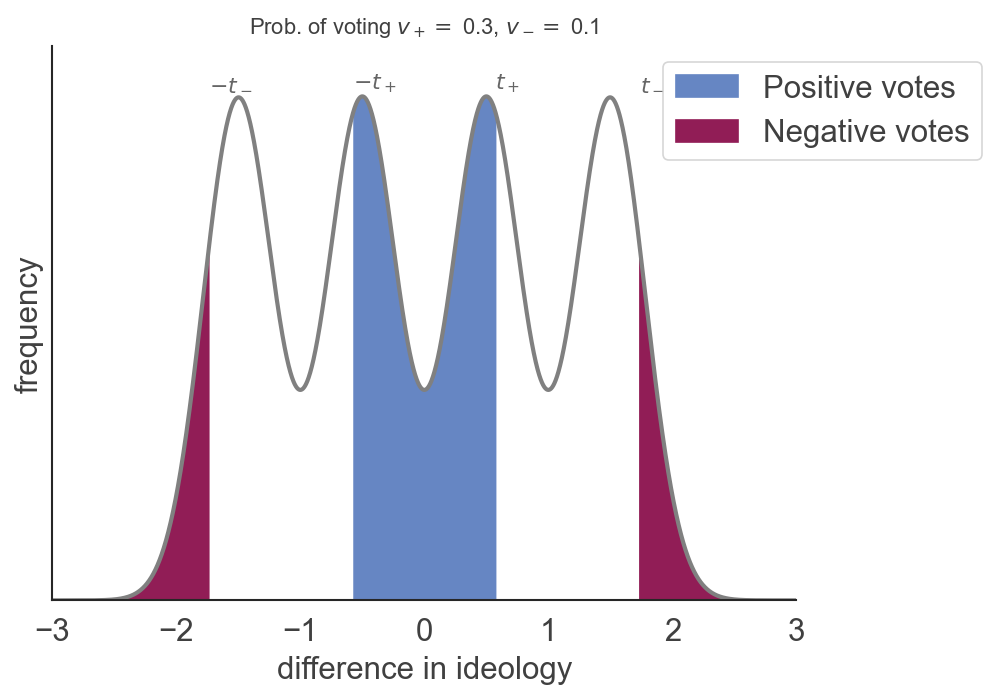

In [5]:
x = np.linspace(-5,5, 10000)

y = difference_gaussian_mixtures(x,
                                 A = amplitude,
                                 B = amplitude,
                                 mu_1 = - dist_stories,
                                 mu_2 = + dist_stories,
                                 mu_3 = - dist_users,
                                 mu_4 = + dist_users,
                                 sigma_1 = sigma,
                                 sigma_2 = sigma,
                                 sigma_3 = sigma,
                                 sigma_4 = sigma, cdf = False)

plt.plot(x, y, color ='grey')
plt.fill_between(x, y , where = (np.abs(x) < t_plus), color='#6686C3', alpha=1, label ='Positive votes')
plt.fill_between(x, y , where = (np.abs(x) > t_minus), color='#911D56', alpha=1, label = "Negative votes")

plt.text(x = t_plus, y = max(y)+0.005, s = '$t_+$', alpha = 0.8)
plt.text(x = -t_plus, y = max(y)+0.005, s = '$-t_+$', alpha = 0.8)
plt.text(x = t_minus, y = max(y)+0.005, s = '$t_-$', alpha = 0.8)
plt.text(x = -t_minus, y = max(y)+0.005, s = '$-t_-$', alpha = 0.8)

plt.xlabel('difference in ideology',size = 15)
plt.ylabel('frequency',size = 15)
plt.title(f'Prob. of voting $v_+ =$ {(v_pos)}, $v_- =$ {(v_neg)}')
plt.ylim(0,max(y)+ (0.1*max(y)))
plt.xlim(-3,3)
plt.yticks([])
plt.xticks(size =15)
plt.legend(fontsize =15, bbox_to_anchor = (0.8,1))
plt.show()

## Sample from Gaussian Mixtures


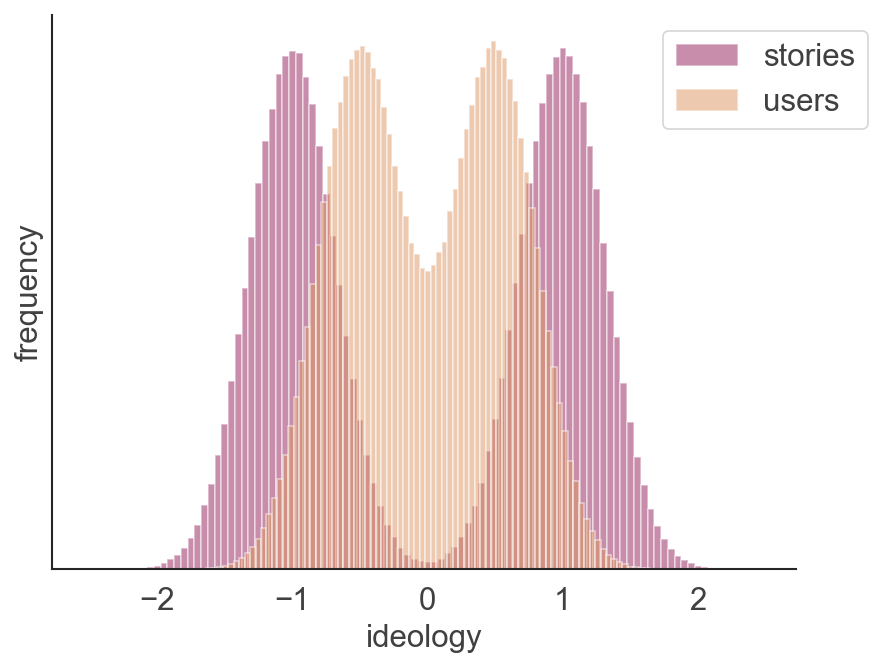

In [6]:
# EXAMPLE
sigma = 0.1
x = np.linspace(-5,5, 10000)

y = difference_gaussian_mixtures(x,
                                 A = amplitude,
                                 B = amplitude,
                                 mu_1 = - dist_stories,
                                 mu_2 = + dist_stories,
                                 mu_3 = - dist_users,
                                 mu_4 = + dist_users,
                                 sigma_1 = sigma,
                                 sigma_2 = sigma,
                                 sigma_3 = sigma,
                                 sigma_4 = sigma, cdf = False)
   

#plt.plot(x, y, color ='grey')
plt.hist(gaussian_mix(A=amplitude,
                      mu_a=- dist_stories,
                                 mu_b = + dist_stories,sigma_a = sigma,
                                 sigma_b = sigma,n_samples = 1000000)[0], bins = 100, alpha = 0.5, label='stories', density = True, color = '#911D56')

plt.hist(gaussian_mix(A=amplitude,
                      mu_a=- dist_users,
                                 mu_b = + dist_users,sigma_a = sigma,
                                 sigma_b = sigma,n_samples = 1000000)[0], bins = 100,  alpha =0.5, label = 'users', density = True, color = '#DD9562')

plt.xlabel('ideology', size =15)
plt.ylabel('frequency', size =15)
plt.yticks([])
plt.xticks(size = 15)
plt.legend(fontsize =15, bbox_to_anchor = (0.8,1))
plt.show()

In [7]:
path = './data/meneame/real-data/'
df = pd.read_csv(path + 'df_stories_votes.tsv.gz', sep="\t", compression="gzip")

In [8]:
# degree sequence bipartite network
df_g = df.groupby(by=['username_vote','story_vote'])[["story_id"]].count().reset_index()
df_g = pd.pivot_table(df_g, values='story_id', index=['username_vote'], columns=['story_vote'], aggfunc=np.sum, fill_value=0)
deg_p_real, deg_m_real = df_g[1].values, df_g[-1].values

### Voting probability

$$v_+ = \frac{1}{n} \langle v_+(u) \rangle$$
$$v_- = \frac{1}{n} \langle v_-(u) \rangle$$


where $n$ is the number of stories in the main page, $v_+(u)$ is the number of positive votes of user $u$, and the average is performed on the users.

In [9]:
v_pos, v_neg = prob_voting(df, queue=False)

In [10]:
print(f'voting prob. positive: {round(v_pos*100, 5)}%\nvoting prob. negative: {round(v_neg*100,5)}%')

voting prob. positive: 1.30741%
voting prob. negative: 0.15602%


In [11]:
voters = len(df.loc[df['queue'] == False].username_vote.unique().tolist())
voted_stories = len(df.loc[df['queue'] == False].story_id.unique().tolist())


print(f'number of voters in main page: {voters}\nnumber of stories with votes in main page: {voted_stories}')

number of voters in main page: 10670
number of stories with votes in main page: 8543


In [12]:
sigma = 0.1
amplitude = 0.5

frac = voted_stories/voters

# simulation with 1000 users and a proportional number of stories
n_users = 1000
n_stories = int(frac * n_users)

deg_p_seq, deg_m_seq = sample_deg_sequence(deg_p_real, deg_m_real, n_users)

## Possible scenarios

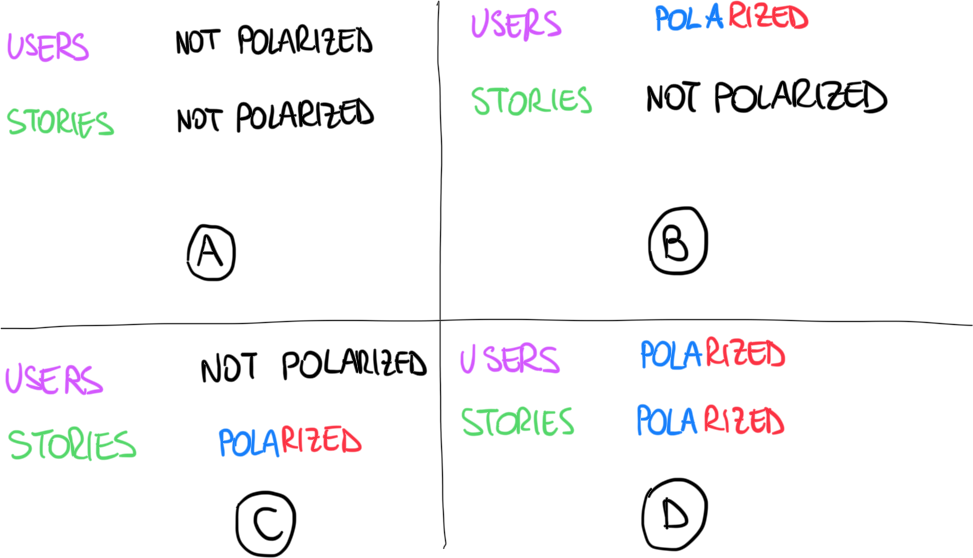

In [13]:
scenarios = [(0,0), (0,1), (1,0), (1,1)]
structural_balance = np.array([np.zeros(7),np.zeros(7),np.zeros(7),np.zeros(7)])

In [14]:
#determine t_+ and t_- for each scenario
t_p, t_m = thresholds_scenarios(amplitude, sigma, v_pos, v_neg)

t_+ = 0.0023174240658419398
t_- = 0.44735085852936607

t_+ = 0.6854783065478149
t_- = 1.4179881855280057

t_+ = 0.6854783065478147
t_- = 1.4179881855280057

t_+ = 0.004635470621640787
t_- = 2.3867669561857876



4it [00:03,  1.00it/s]


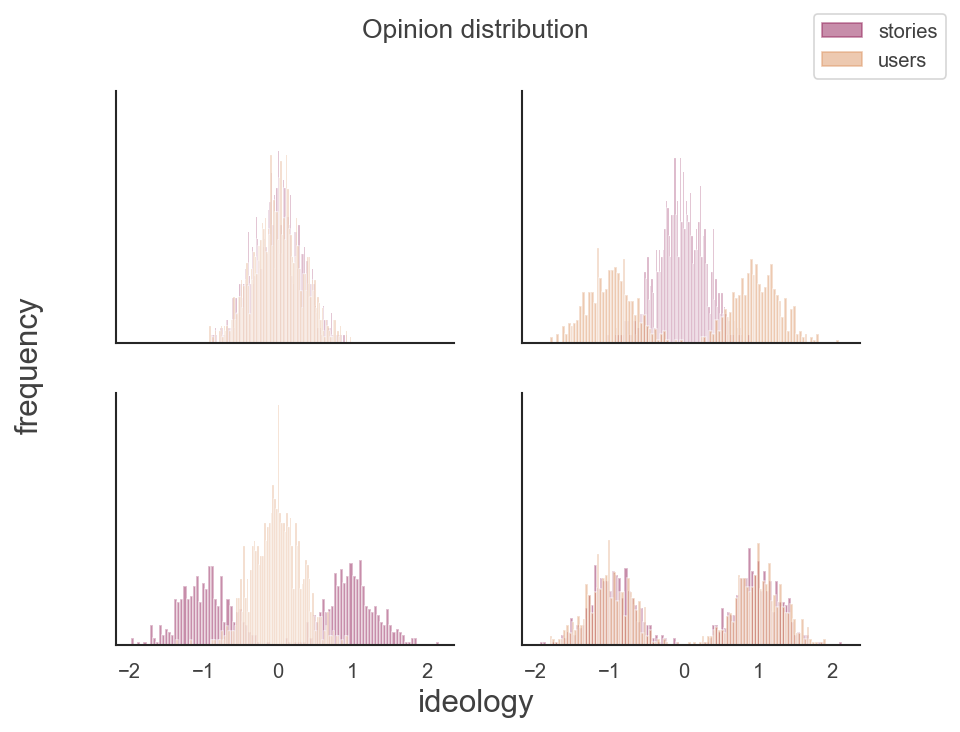

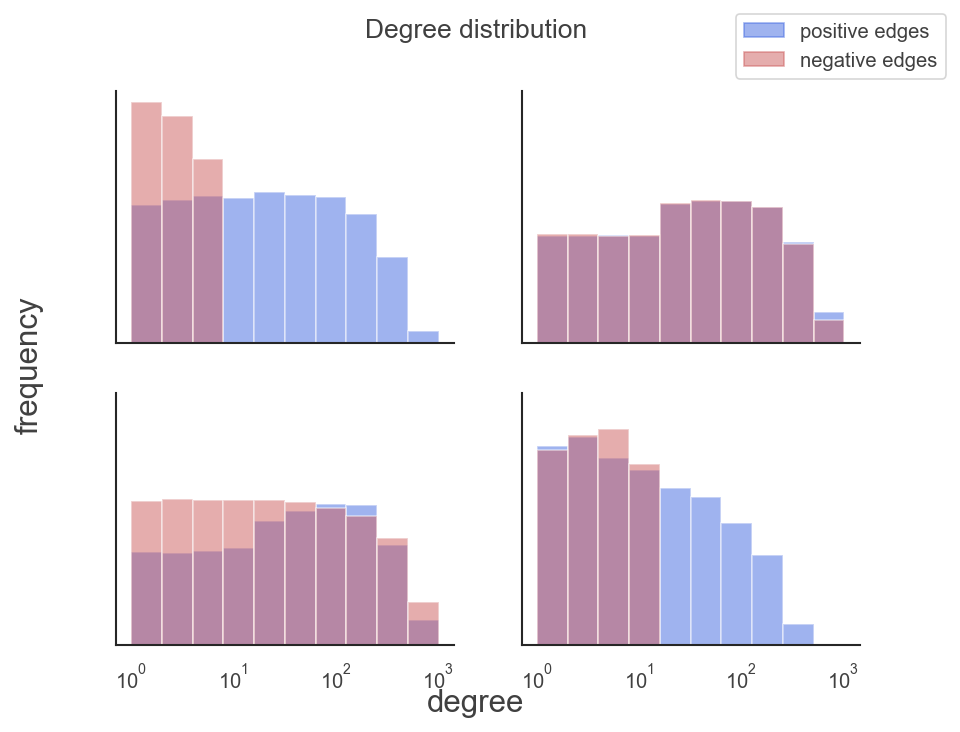

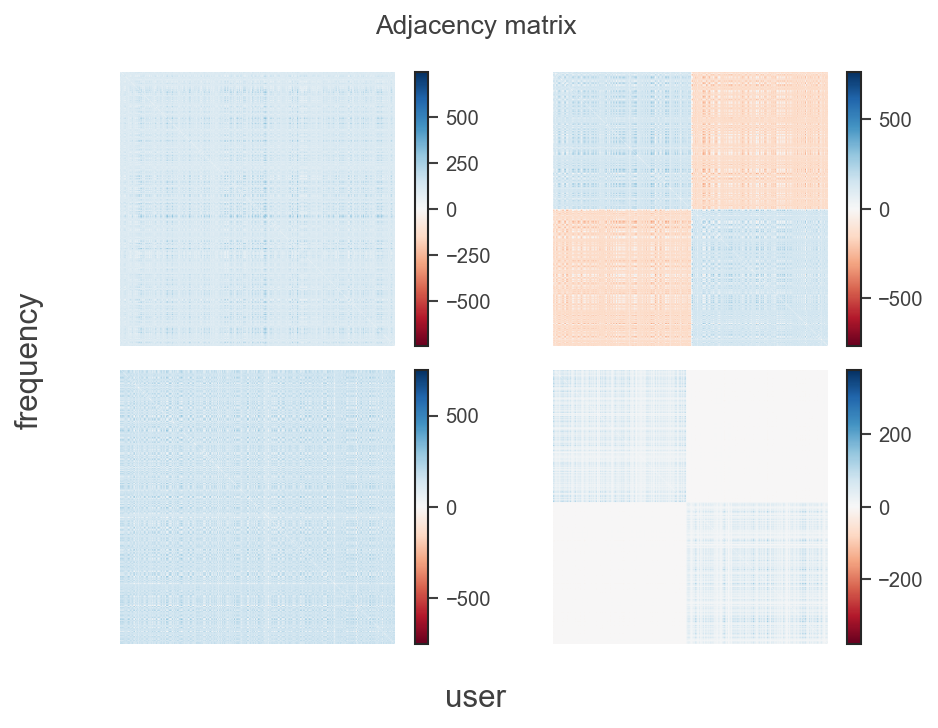

In [15]:
# Define constants
paths = ['u_np_s_np.pkl', 'u_p_s_np.pkl', 'u_np_s_p.pkl', 'u_p_s_p.pkl']
path_adj = './data/meneame/synth/uniform/adj/'
path_label = './data/meneame/synth/uniform/label/'

# Create subplots
figs, axs = zip(*[plt.subplots(2, 2, sharex=True, sharey=True) for _ in range(3)])

# Set titles
titles = ['Opinion distribution', 'Degree distribution', 'Adjacency matrix']
for fig, title in zip(figs, titles):
    fig.suptitle(title)

# Process each scenario
for i, scenario in tqdm(enumerate(scenarios)):
    dist_users, dist_stories = scenario
    t_plus, t_minus = t_p[scenario], t_m[scenario]
    users, users_labels, stories, stories_labels = plot_hist(amplitude, dist_users, dist_stories, sigma, n_users, n_stories, ax=axs[0].flat[i])

    # Create adjacency matrix
    mat = fill_mat(users, stories, t_plus, t_minus, deg_p_seq, deg_m_seq, deg_corr = False)
    A = (csr_matrix(mat) @ csr_matrix(mat).T).todense()
    np.fill_diagonal(A, 0)

    # Plot adjacency matrix
    im = axs[2].flat[i].imshow(A, cmap='RdBu', vmin=-np.max(A), vmax=np.max(A))
    axs[2].flat[i].axis('off')
    plt.colorbar(im, ax=axs[2].flat[i])

    # Calculate balanced triangles
    #sb[i] = np.array(fraction_balanced_triangles(A))

    # Save adjacency matrix and labels
    for path, data in zip([path_adj, path_label], [A, users_labels]):
        create_directory(path)
        #with open(path + paths[i], 'wb') as f:
         #   pickle.dump(data, f)

    # Plot degree distribution
    plot_deg_distr(A, ax=axs[1].flat[i])

# Add legends
legends = [legend1, legend2]
colors = [colors1, colors2]
for fig, legend, color in zip(figs[:2], legends, colors):
    patches = [mpatches.Patch(color=c, label=l, alpha=0.5) for c, l in zip(color, legend)]
    fig.legend(handles=patches, bbox_to_anchor=(1, 1))

# Set labels
labels = ['ideology', 'degree', 'user']
for fig, label in zip(figs, labels):
    fig.supxlabel(label, size=15)
    fig.supylabel('frequency', size=15)

plt.tight_layout()
plt.show()

# Degree-corrected version of the mechanism

4it [00:00,  4.07it/s]


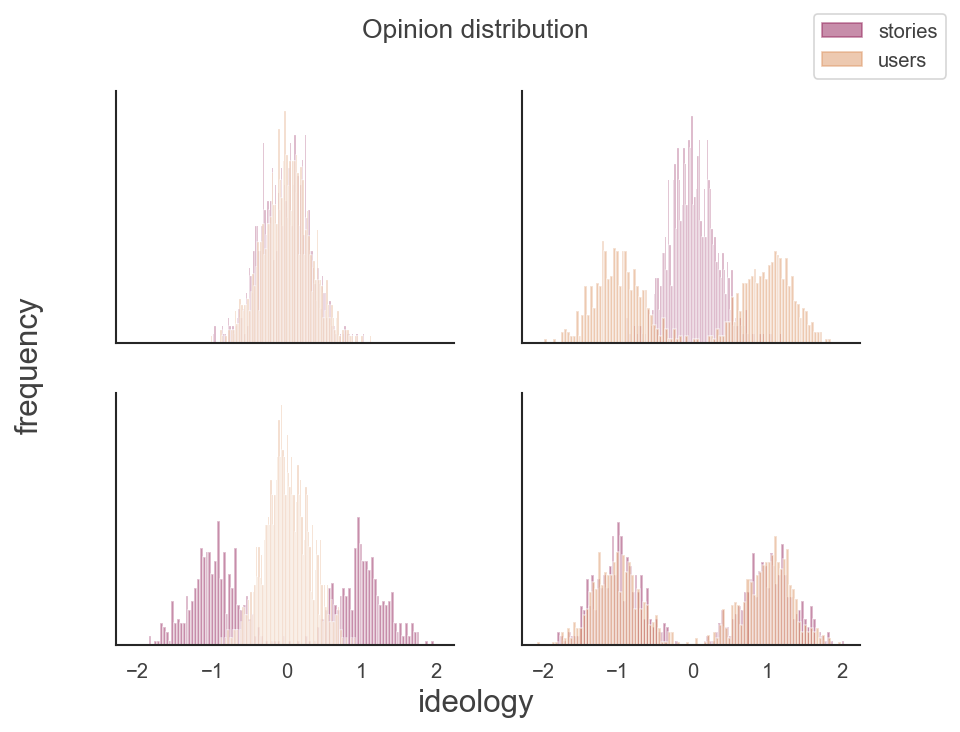

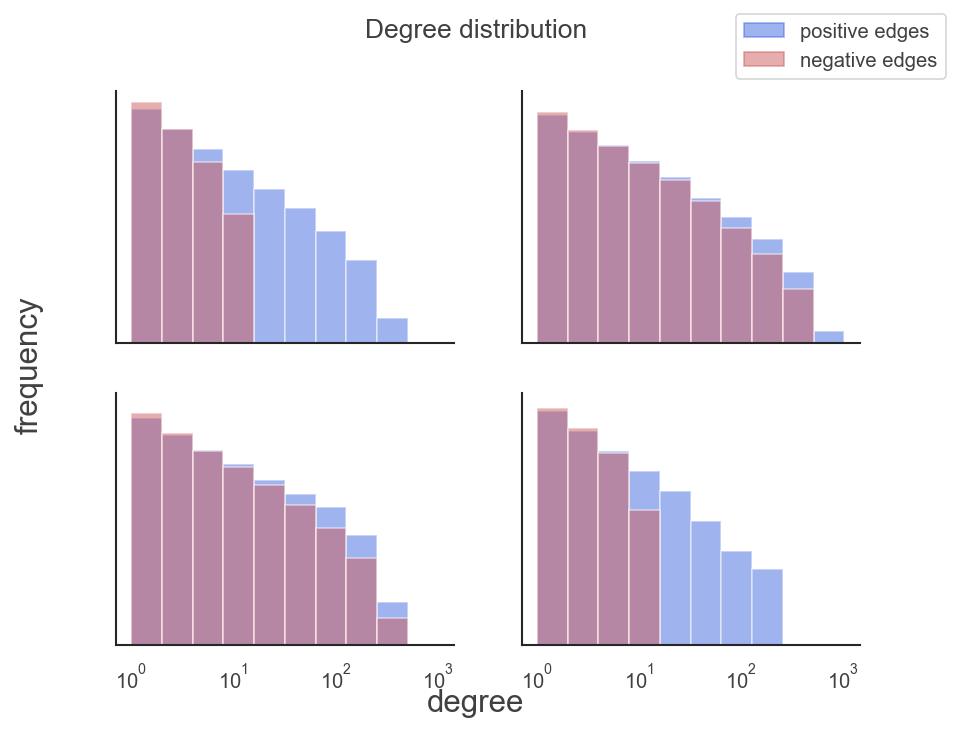

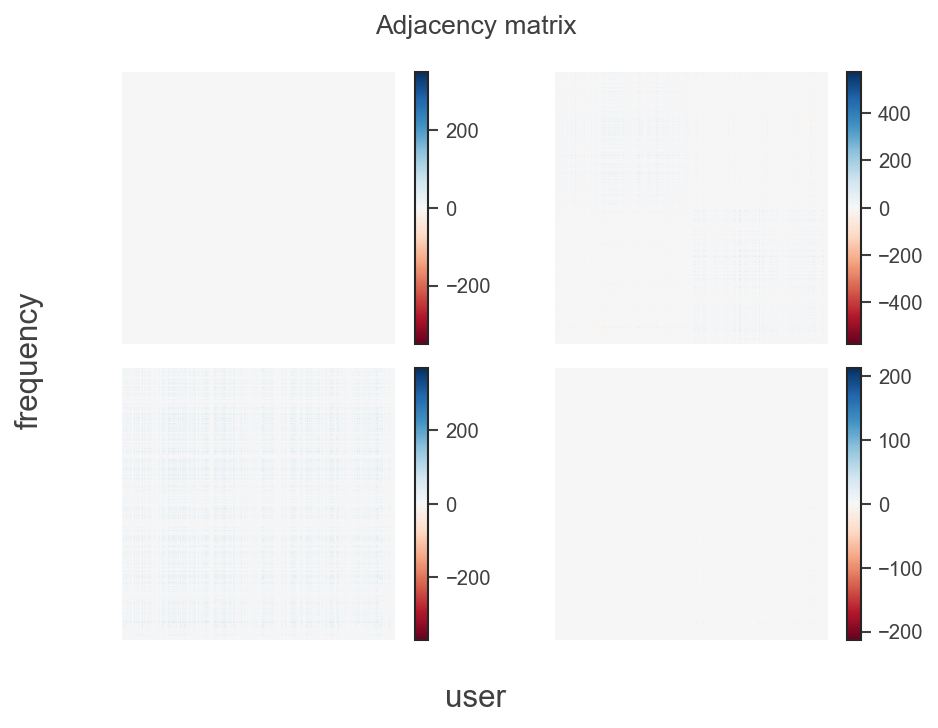

In [16]:
paths = ['u_np_s_np.pkl', 'u_p_s_np.pkl', 'u_np_s_p.pkl', 'u_p_s_p.pkl']
path_adj = './data/meneame/synth/uniform/adj/'
path_label = './data/meneame/synth/uniform/label/'
# Create subplots
figs, axs = zip(*[plt.subplots(2, 2, sharex=True, sharey=True) for _ in range(3)])

# Set titles
titles = ['Opinion distribution', 'Degree distribution', 'Adjacency matrix']
for fig, title in zip(figs, titles):
    fig.suptitle(title)

# Process each scenario
for i, scenario in tqdm(enumerate(scenarios)):
    dist_users, dist_stories = scenario
    t_plus, t_minus = t_p[scenario], t_m[scenario]
    users, users_labels, stories, stories_labels = plot_hist(amplitude, dist_users, dist_stories, sigma, n_users, n_stories, ax=axs[0].flat[i])

    # Create adjacency matrix
    mat = fill_mat(users, stories, t_plus, t_minus, deg_p_seq, deg_m_seq, deg_corr = True)
    A = (csr_matrix(mat) @ csr_matrix(mat).T).todense()
    np.fill_diagonal(A, 0)

    # Plot adjacency matrix
    im = axs[2].flat[i].imshow(A, cmap='RdBu', vmin=-np.max(A), vmax=np.max(A))
    axs[2].flat[i].axis('off')
    plt.colorbar(im, ax=axs[2].flat[i])

    # Calculate balanced triangles
    #sb[i] = np.array(fraction_balanced_triangles(A))

    # Save adjacency matrix and labels
    for path, data in zip([path_adj, path_label], [A, users_labels]):
        create_directory(path)
        #with open(path + paths[i], 'wb') as f:
        #    pickle.dump(data, f)

    # Plot degree distribution
    plot_deg_distr(A, ax=axs[1].flat[i])

# Add legends
legends = [legend1, legend2]
colors = [colors1, colors2]
for fig, legend, color in zip(figs[:2], legends, colors):
    patches = [mpatches.Patch(color=c, label=l, alpha=0.5) for c, l in zip(color, legend)]
    fig.legend(handles=patches, bbox_to_anchor=(1, 1))

# Set labels
labels = ['ideology', 'degree', 'user']
for fig, label in zip(figs, labels):
    fig.supxlabel(label, size=15)
    fig.supylabel('frequency', size=15)

plt.tight_layout()
plt.show()

In [18]:
from sklearn.preprocessing import LabelEncoder
df = pd.read_csv('./data/us-house/real-data/clerk_data.tsv', sep='\t', header= None,names=["person", "person_", "party", "state", "state_short", "vote","year","bill"])
df = df.dropna()
df = df.drop(columns=['person_'])
df['vote'] = df['vote'].replace(['Aye', 'Yea'], 'yes')
df['vote'] = df['vote'].replace(['Nay', 'No'], 'no')
df['vote'] = df['vote'].replace(['Not Voting'], 'not_voting')
df['vote'] = df['vote'].replace(['Present'], 'present')
df['call_year'] = df['year'].astype(str) + '_' + df['bill'].astype(str)
df['person_party'] = df['person'].astype(str) + '_' + df['party'].astype(str)
df['call_encoded'] = LabelEncoder().fit_transform(df['call_year'])
df['person_encoded'] = LabelEncoder().fit_transform(df['person_party'])
df['party_encoded'] = LabelEncoder().fit_transform(df['party'])

df['weight'] = df['vote'].replace(['yes', 'no', 'not_voting', 'present'], [1, -1, 0, 0])
df = df.loc[df['year'] != 2023]

In [19]:
def incidence_matrix(df):
    incidence_edgelist = df[['person_encoded', 'call_encoded', 'weight']]
    incidence_matrix_df = incidence_edgelist.pivot(index='person_encoded', columns='call_encoded', values='weight').fillna(0)
    #print(incidence_matrix_df)
    incidence_matrix = csr_matrix(incidence_matrix_df.values)
    return incidence_matrix, incidence_matrix_df.index

In [20]:
df.rename(columns={'call_year': 'story_id', 'weight': 'story_vote', 'person': 'username_vote'}, inplace=True)

In [21]:
v_plus_years , v_minus_years = [], []
for year in df['year'].unique():
    df_year = df[df['year'] == year]

    v_pos, v_neg = prob_voting(df_year, queue=False, meneame=False)
    v_plus_years.append(v_pos)
    v_minus_years.append(v_neg)
    print(f'voting prob. positive: {round(v_pos*100, 5)}%\nvoting prob. negative: {round(v_neg*100,5)}%')

voting prob. positive: 59.67319%
voting prob. negative: 30.02445%
voting prob. positive: 57.73714%
voting prob. negative: 32.08182%
voting prob. positive: 55.17901%
voting prob. negative: 34.78519%
voting prob. positive: 57.06479%
voting prob. negative: 34.65776%
voting prob. positive: 56.4362%
voting prob. negative: 35.41148%
voting prob. positive: 51.88511%
voting prob. negative: 41.82989%
voting prob. positive: 59.53891%
voting prob. negative: 34.60562%
voting prob. positive: 58.24712%
voting prob. negative: 36.18891%
voting prob. positive: 58.15114%
voting prob. negative: 34.03079%
voting prob. positive: 62.97889%
voting prob. negative: 32.26215%
voting prob. positive: 65.18175%
voting prob. negative: 28.06961%
voting prob. positive: 66.08311%
voting prob. negative: 26.83927%
voting prob. positive: 65.99107%
voting prob. negative: 28.09775%
voting prob. positive: 63.96436%
voting prob. negative: 31.1282%
voting prob. positive: 64.98541%
voting prob. negative: 28.49054%
voting prob.

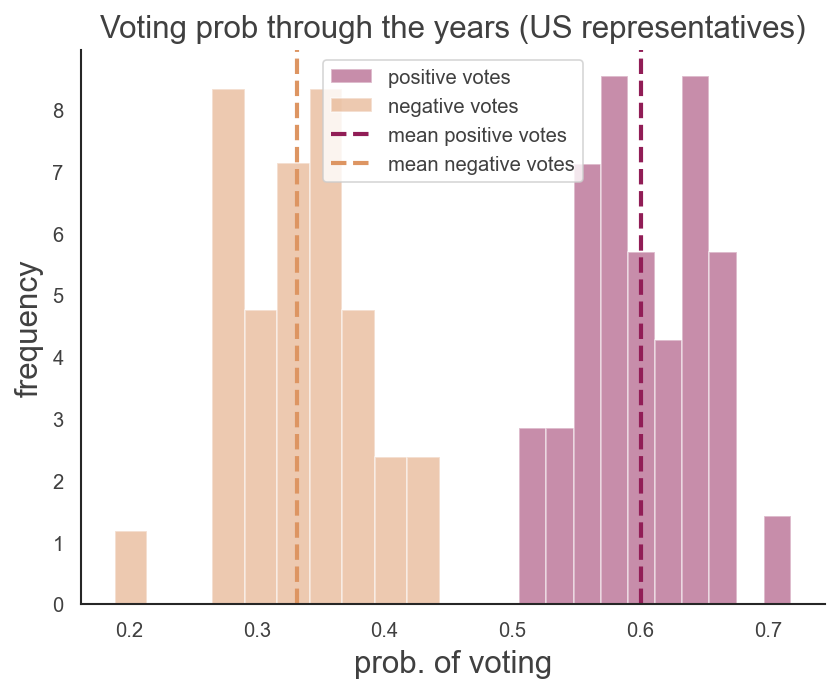

In [22]:
plt.hist(v_plus_years, bins = 10, alpha = 0.5, label='positive votes', density = True, color = '#911D56')
plt.hist(v_minus_years, bins = 10,  alpha =0.5, label = 'negative votes', density = True, color = '#DD9562')
plt.axvline(x = np.mean(v_plus_years), color = '#911D56', linestyle = '--', label = 'mean positive votes')
plt.axvline(x = np.mean(v_minus_years), color = '#DD9562', linestyle = '--', label = 'mean negative votes')
plt.title('Voting prob through the years (US representatives)', size = 15)
plt.xlabel('prob. of voting', size =15)
plt.ylabel('frequency', size =15)
plt.legend()
plt.show()

In [23]:
sigma = 0.1
amplitude = 0.5

frac = voted_stories/voters

# simulation with 1000 users and a proportional number of stories
n_users = 1000
n_stories = int(frac * n_users)


deg_p_seq, deg_m_seq = sample_deg_sequence(df_g[1].values, df_g[-1].values, n_users)
scenarios = [(0,0), (0,1), (1,0), (1,1)]
structural_balance = np.array([np.zeros(7),np.zeros(7),np.zeros(7),np.zeros(7)])

t_+ = 0.11819978969616839
t_- = 0.1464996954732987

t_+ = 1.0346336477116462
t_- = 1.0740620147940698

t_+ = 1.0346336477116462
t_- = 1.0740620147940698

t_+ = 1.8776418319034762
t_- = 1.9639923049558548



4it [00:01,  2.68it/s]


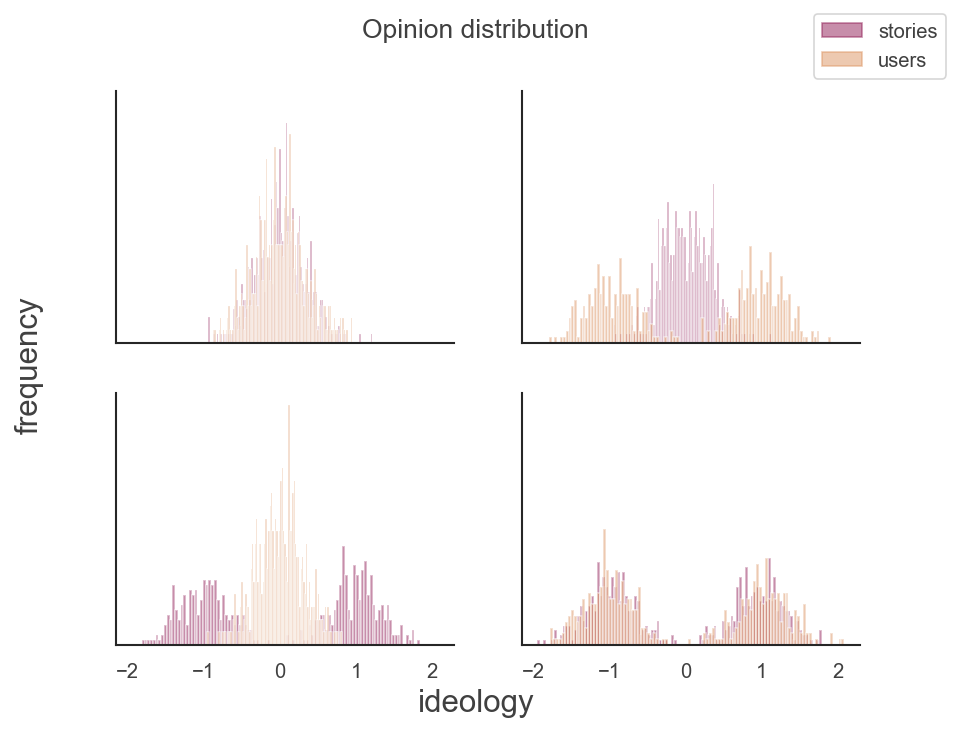

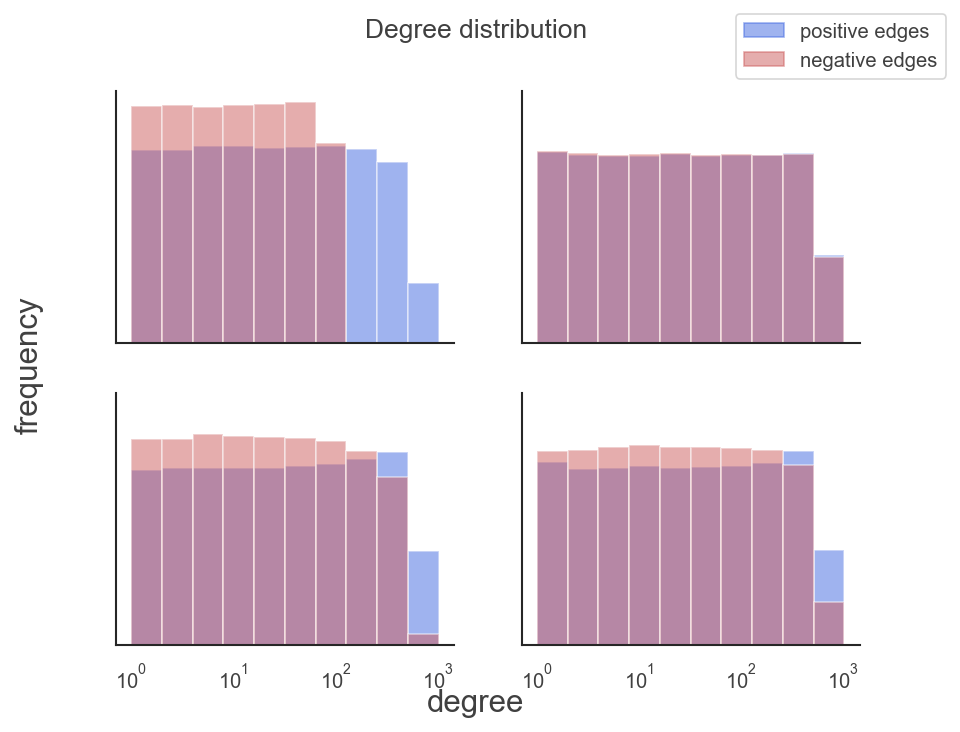

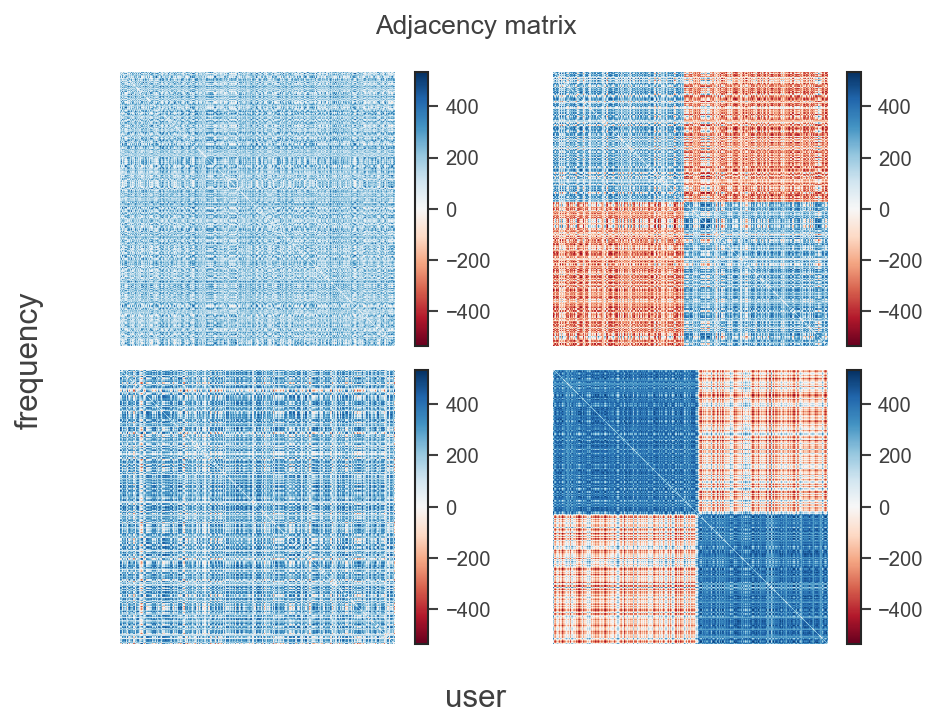

t_+ = 0.11340142467481672
t_- = 0.14040000661255708

t_+ = 1.0276016710411606
t_- = 1.0658192167576335

t_+ = 1.0276016710411608
t_- = 1.0658192167576335

t_+ = 1.8562731402165726
t_- = 1.9486872266403628



4it [00:01,  3.54it/s]


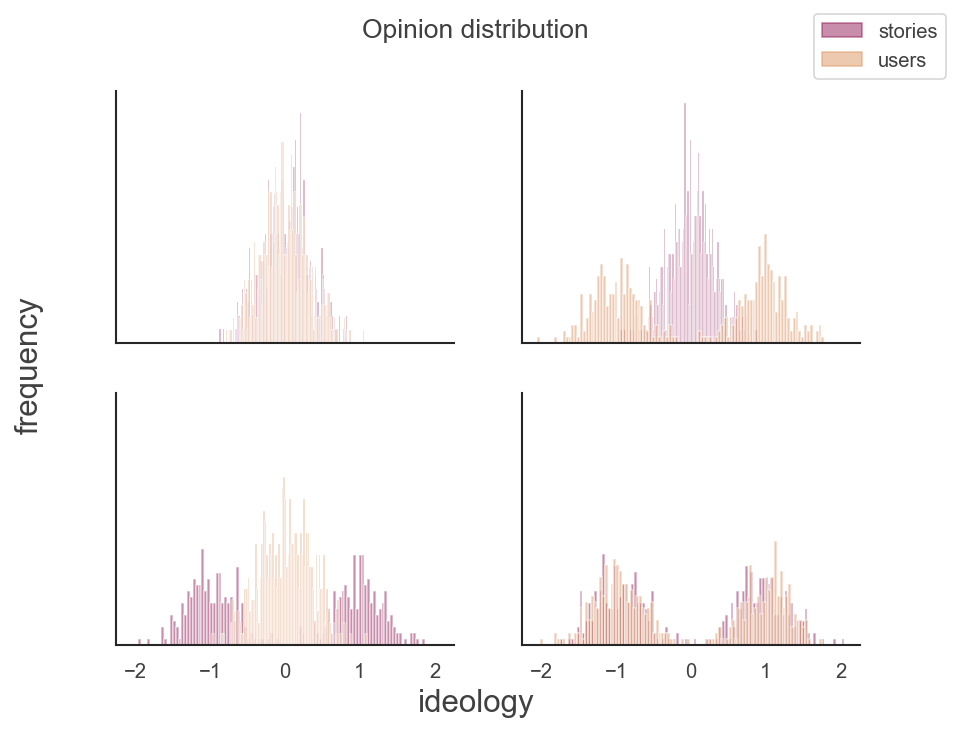

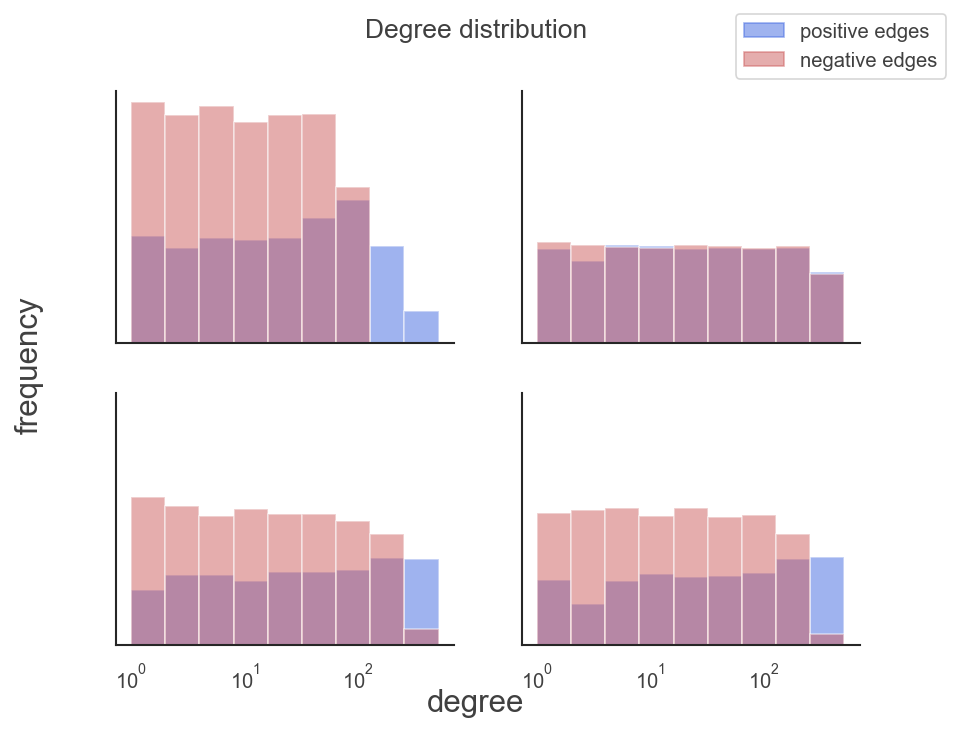

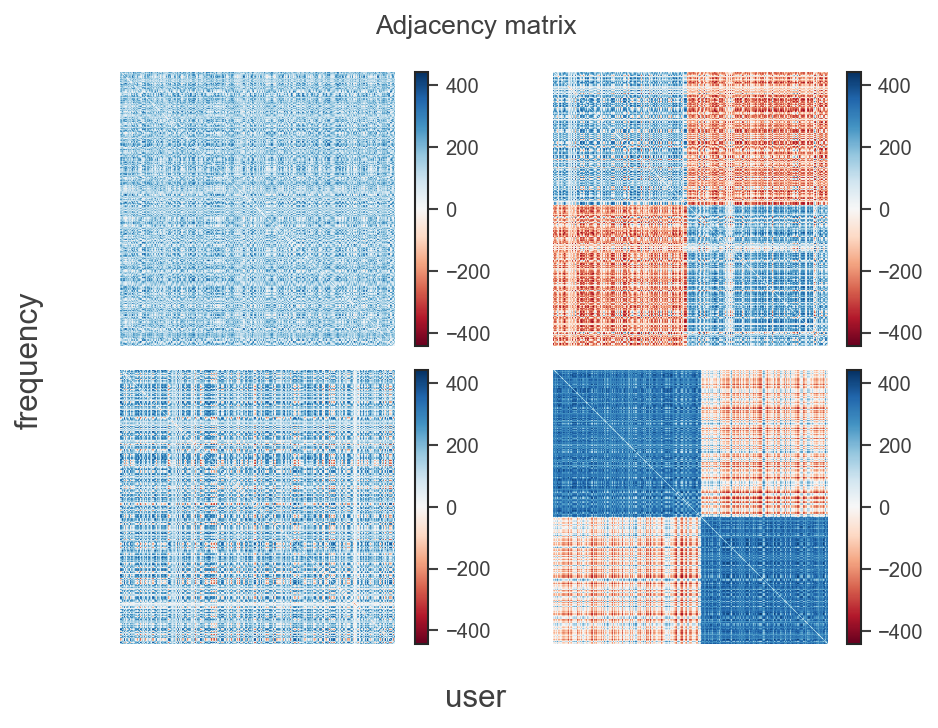

t_+ = 0.10725434563387587
t_- = 0.1327612869547023

t_+ = 1.0184109819786473
t_- = 1.0553136297844394

t_+ = 1.0184109819786473
t_- = 1.0553136297844394

t_+ = 1.8216093677241911
t_- = 1.9275804272727899



4it [00:01,  2.77it/s]


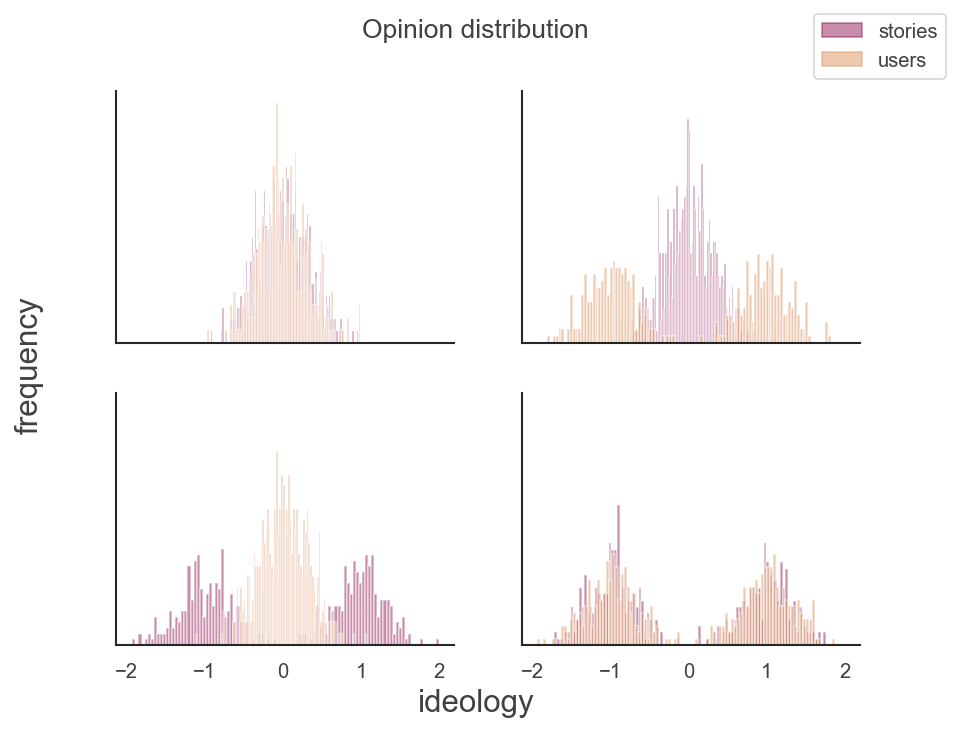

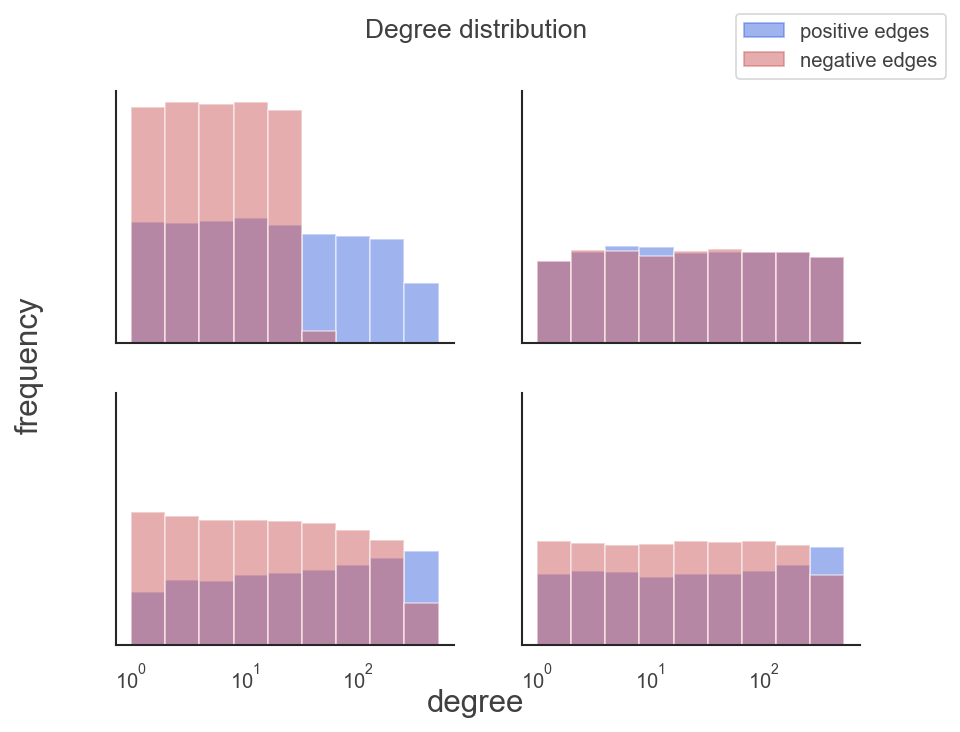

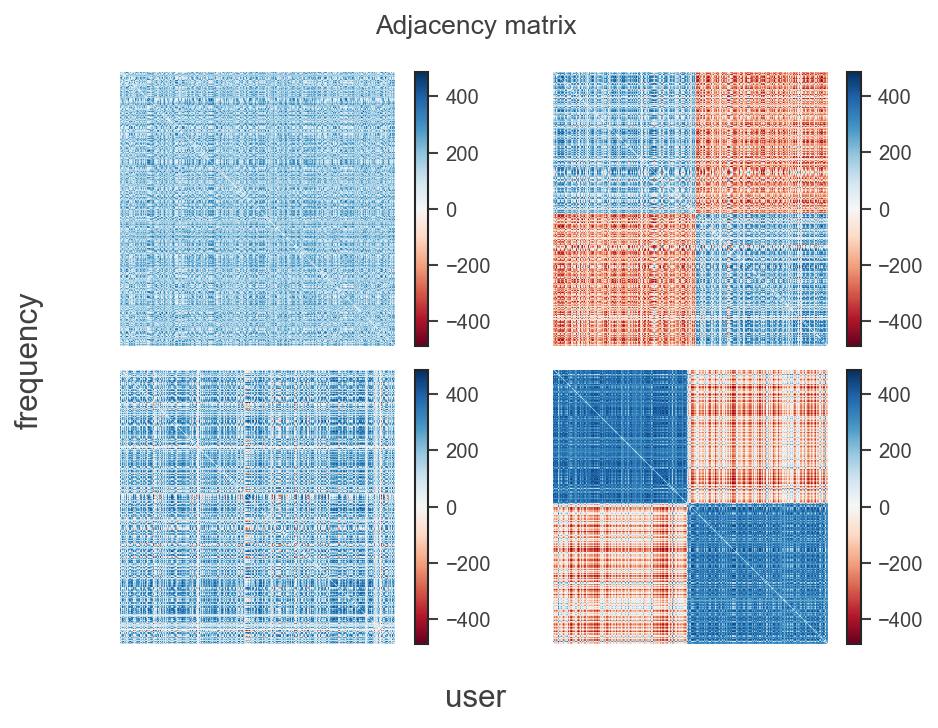

t_+ = 0.11176542263502873
t_- = 0.1331126211971888

t_+ = 1.025176392709498
t_- = 1.0558015958974682

t_+ = 1.025176392709498
t_- = 1.0558015958974682

t_+ = 1.848040564528252
t_- = 1.9286085483467448



4it [00:01,  2.59it/s]


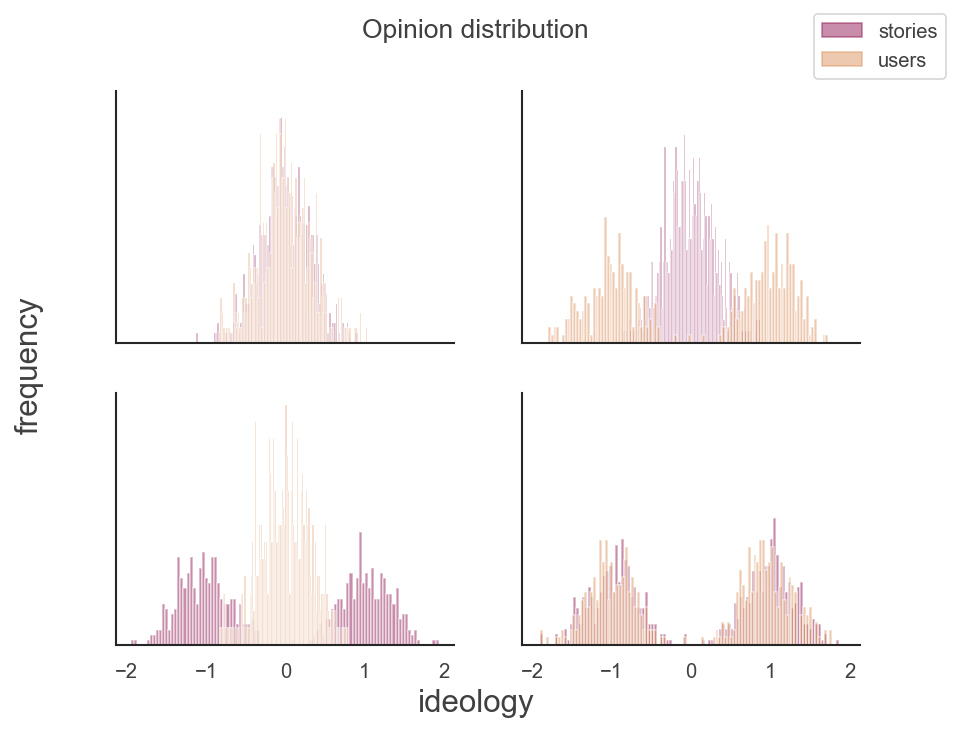

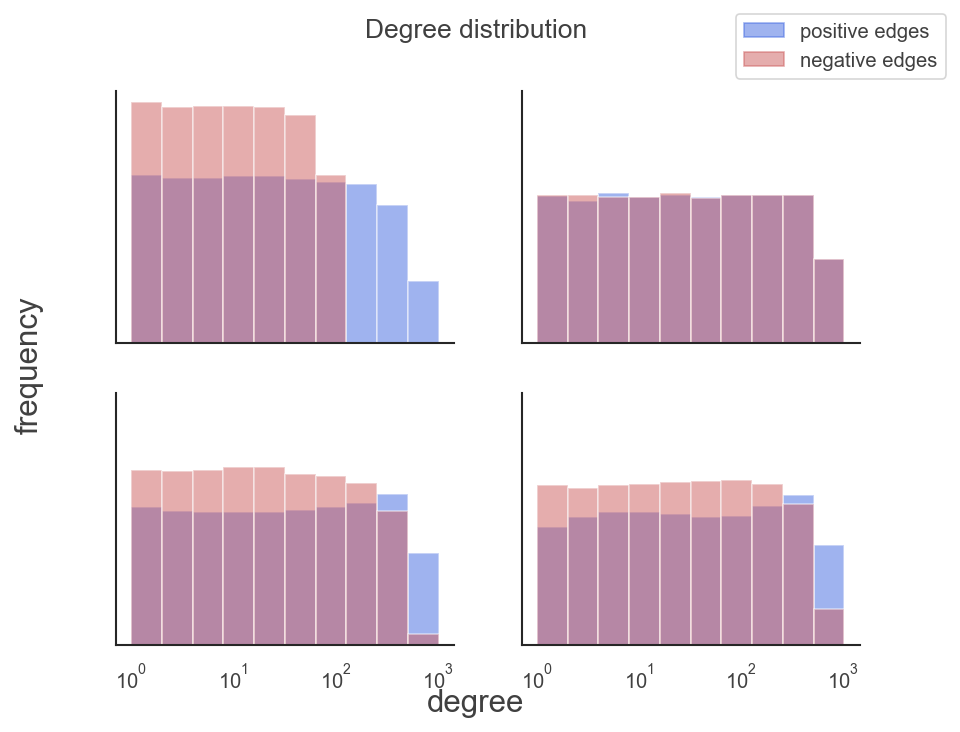

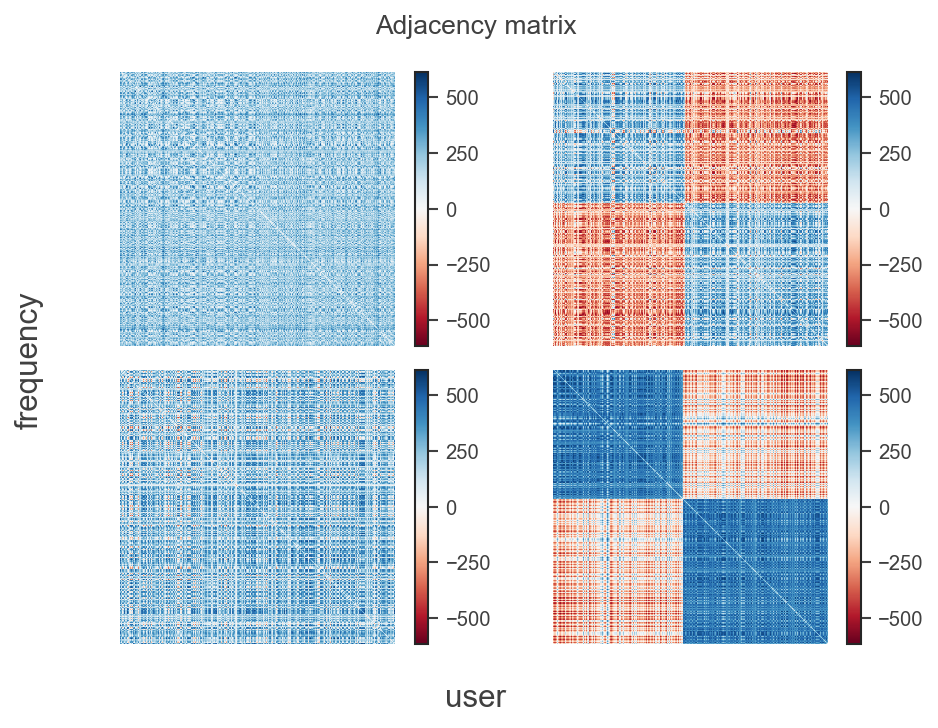

t_+ = 0.11024928559679256
t_- = 0.13104632837494343

t_+ = 1.0229156106475523
t_- = 1.0529248030546492

t_+ = 1.022915610647552
t_- = 1.0529248030546492

t_+ = 1.839848256728125
t_- = 1.9224699809260226



4it [00:01,  3.28it/s]


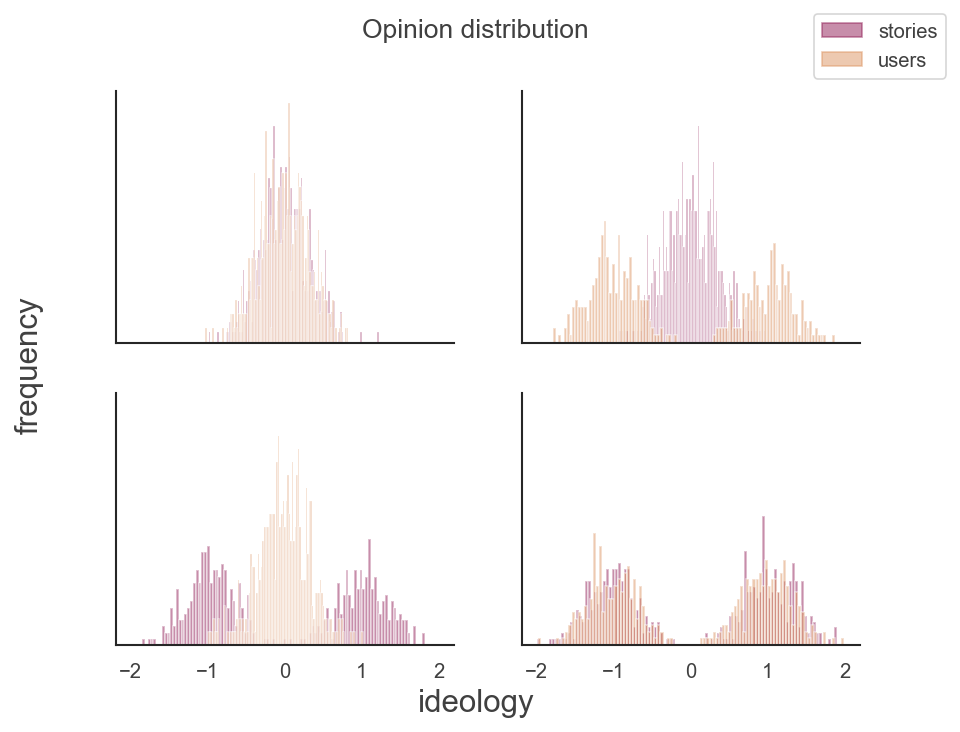

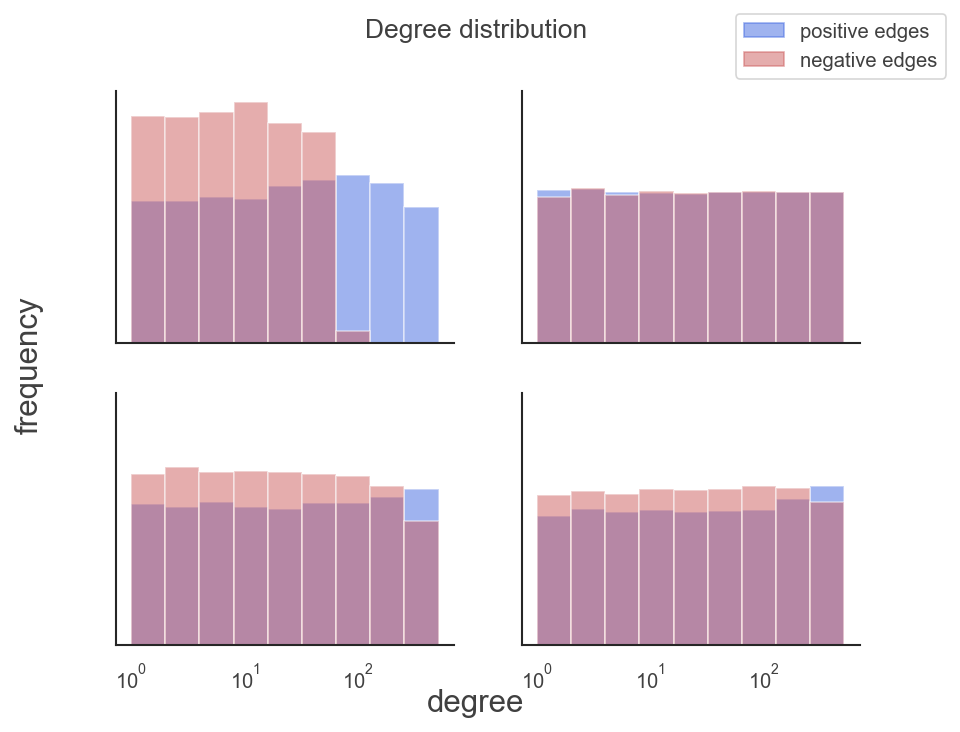

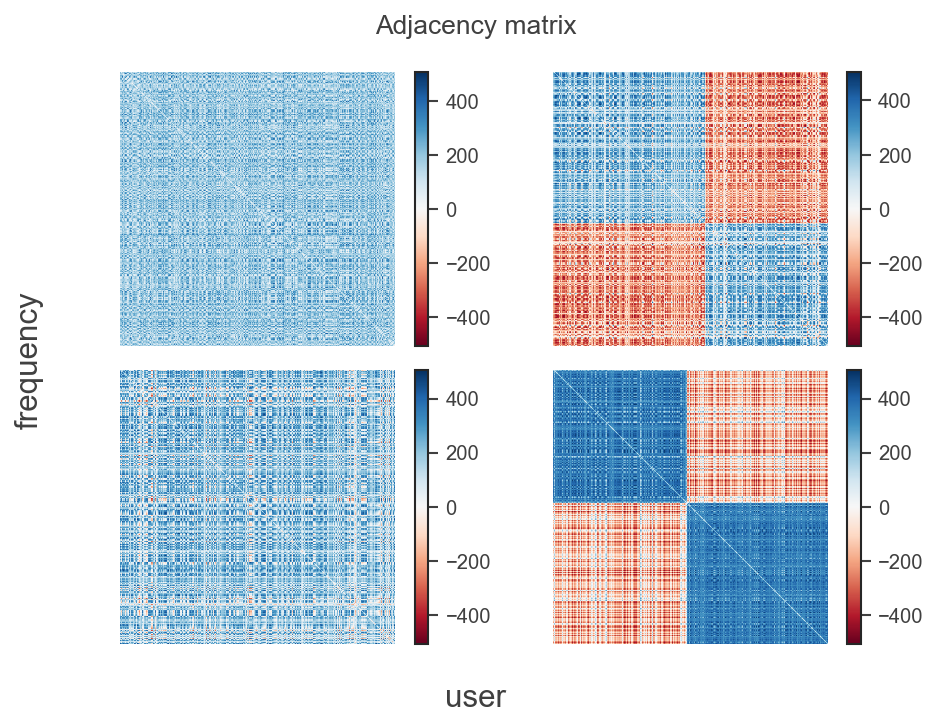

t_+ = 0.0996251126533345
t_- = 0.11446304448317701

t_+ = 1.006685034199893
t_- = 1.0291677508606136

t_+ = 1.006685034199893
t_- = 1.0291677508606136

t_+ = 1.7485533414768895
t_- = 1.86132629972495



4it [00:01,  2.24it/s]


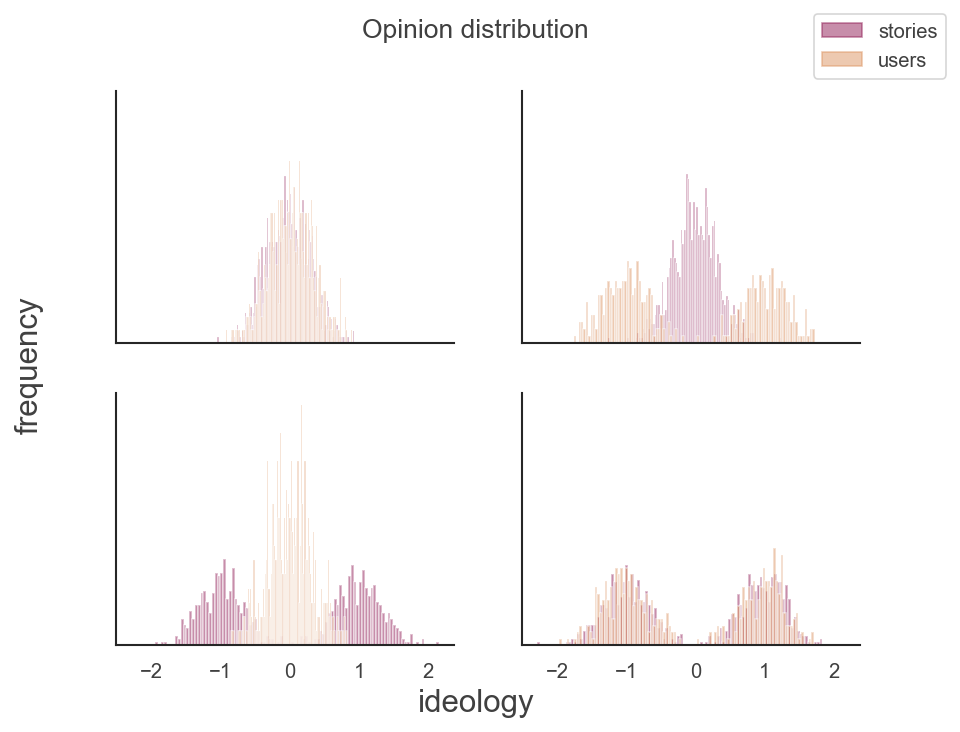

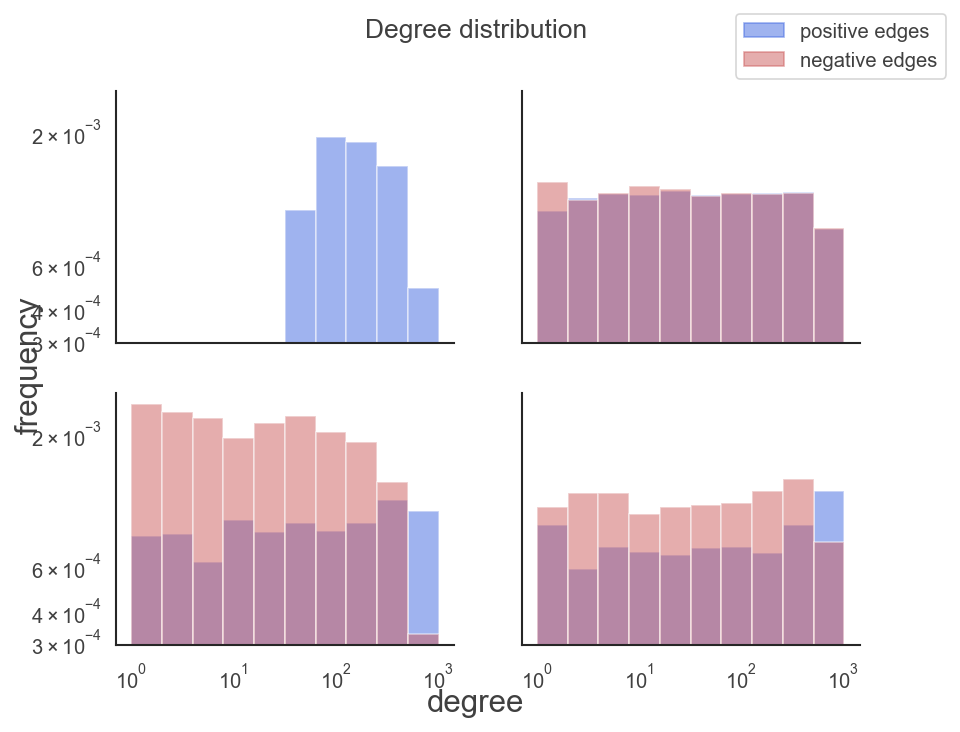

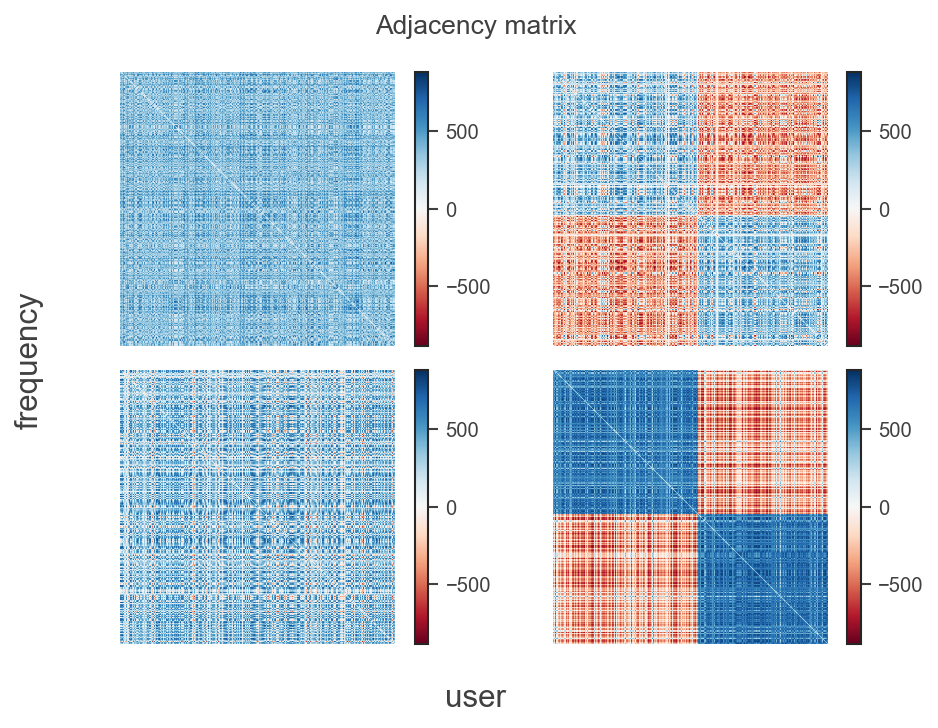

t_+ = 0.11786263922720105
t_- = 0.13325660448279994

t_+ = 1.0341433773677549
t_- = 1.0560014355735874

t_+ = 1.0341433773677549
t_- = 1.0560014355735874

t_+ = 1.8762517852328804
t_- = 1.9290281094115118



4it [00:01,  2.83it/s]


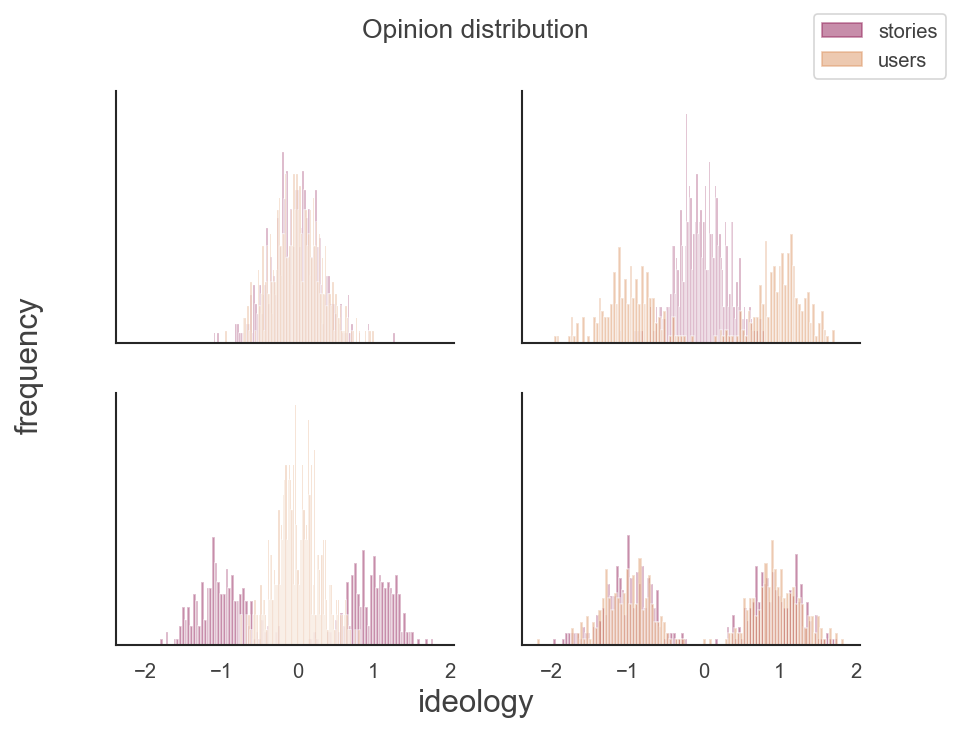

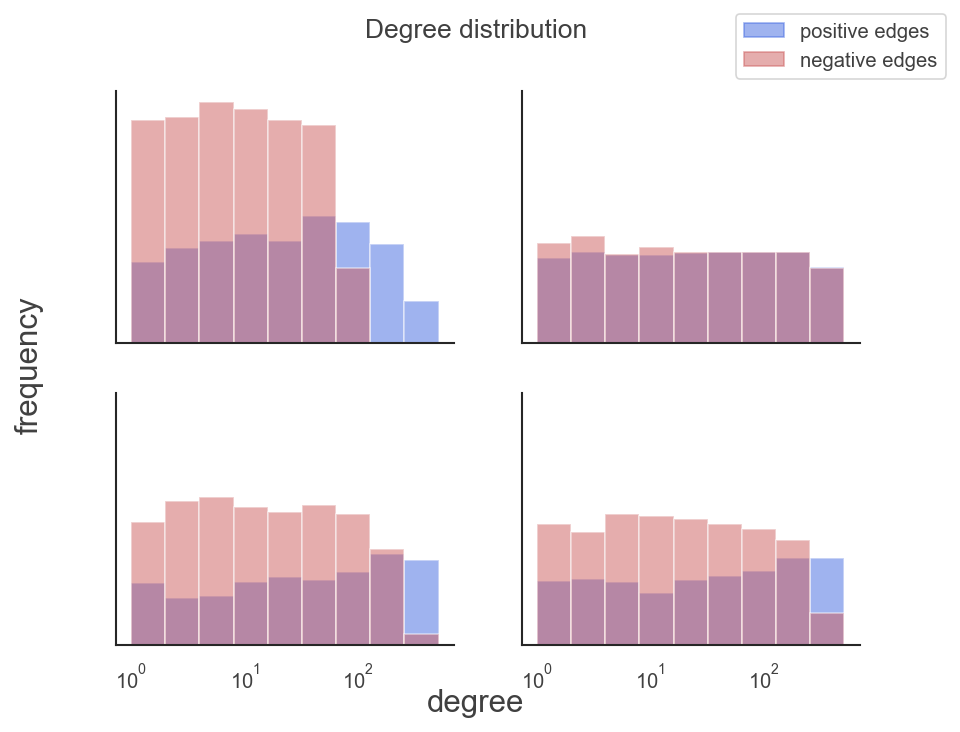

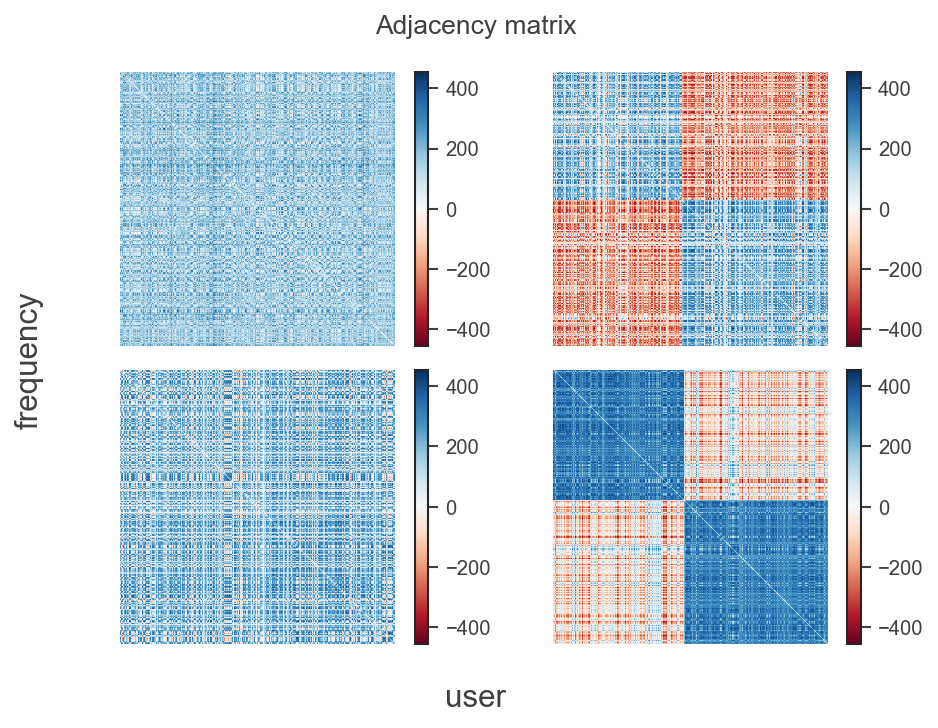

t_+ = 0.11465254734038312
t_- = 0.12894393762101813

t_+ = 1.0294466742110702
t_- = 1.0499802639873683

t_+ = 1.0294466742110702
t_- = 1.0499802639873683

t_+ = 1.862206653609775
t_- = 1.9159812211937692



4it [00:01,  2.57it/s]


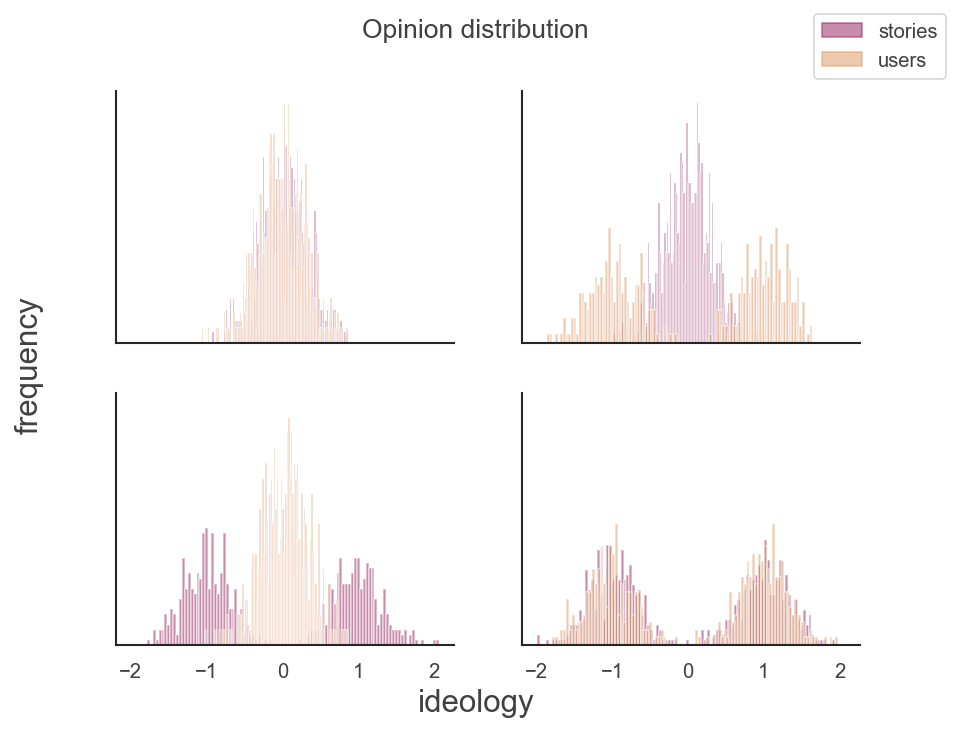

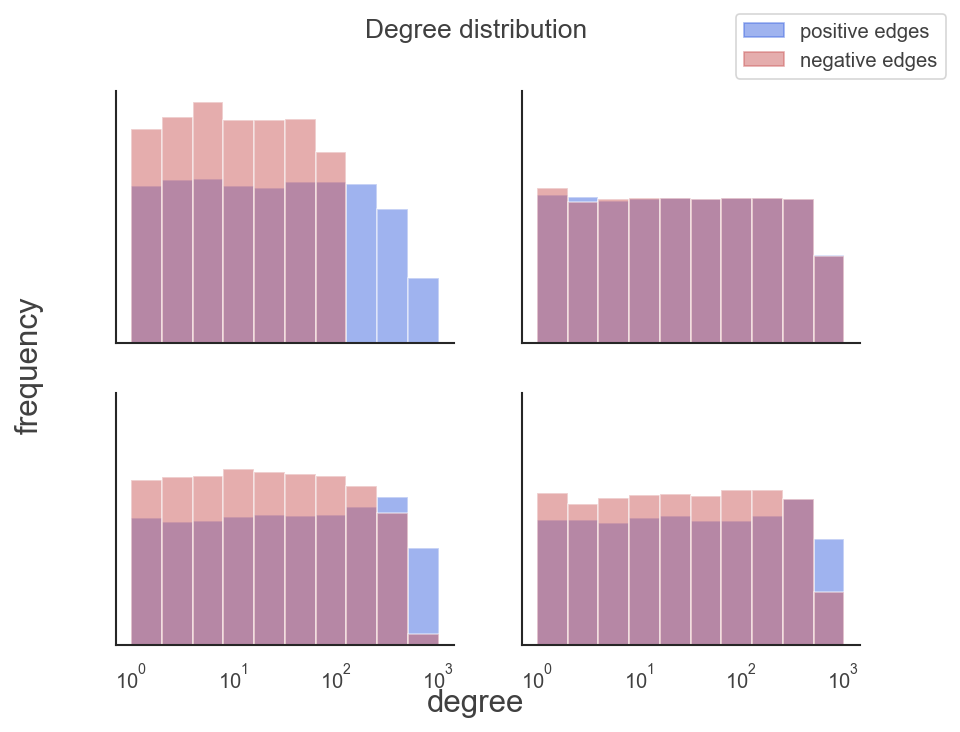

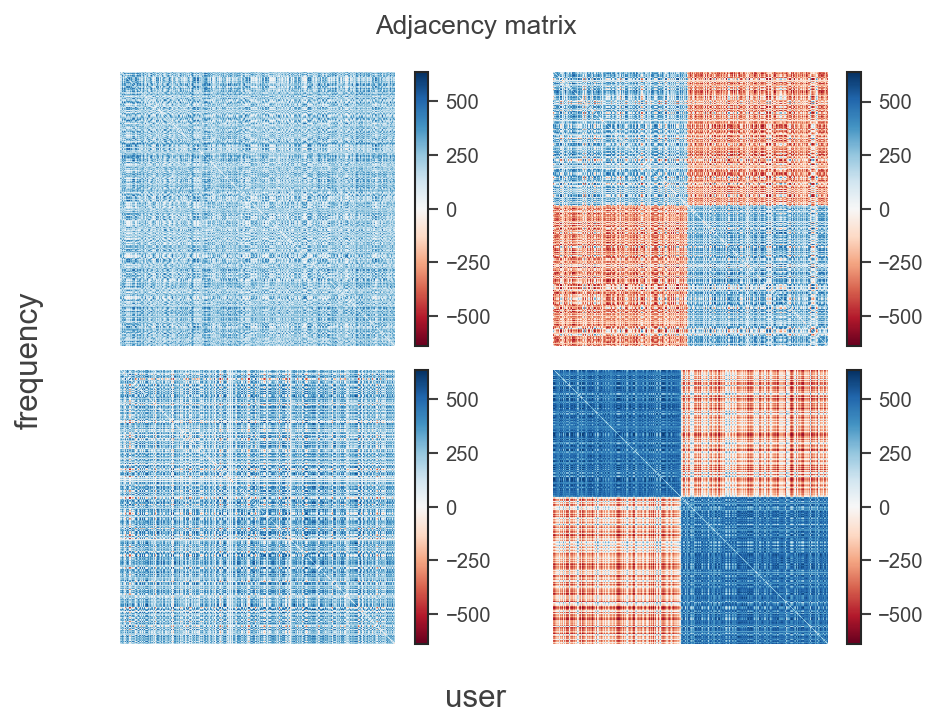

t_+ = 0.11441641404634607
t_- = 0.13485334266374613

t_+ = 1.0290990880117468
t_- = 1.0582122910258747

t_+ = 1.0290990880117468
t_- = 1.0582122910258747

t_+ = 1.861108701337223
t_- = 1.9336138062807862



4it [00:01,  3.22it/s]


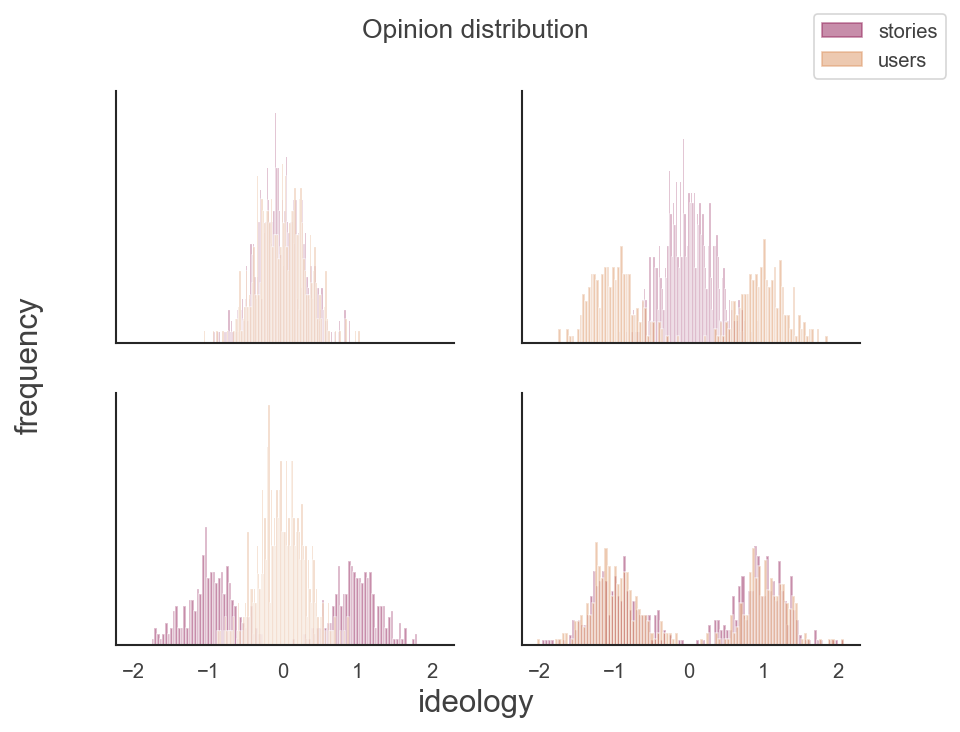

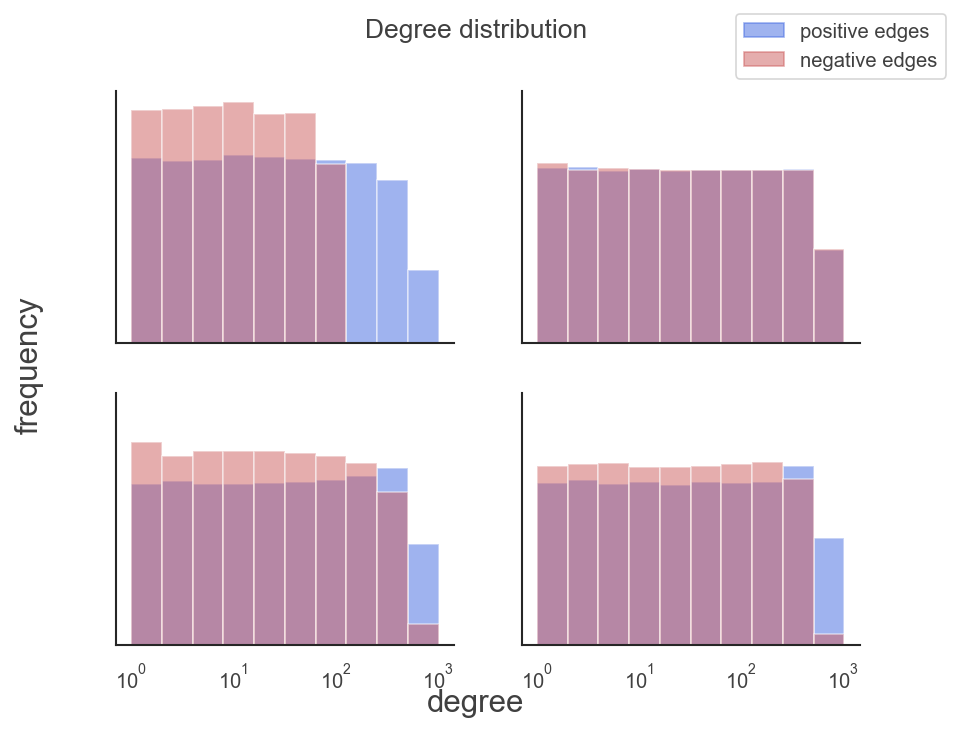

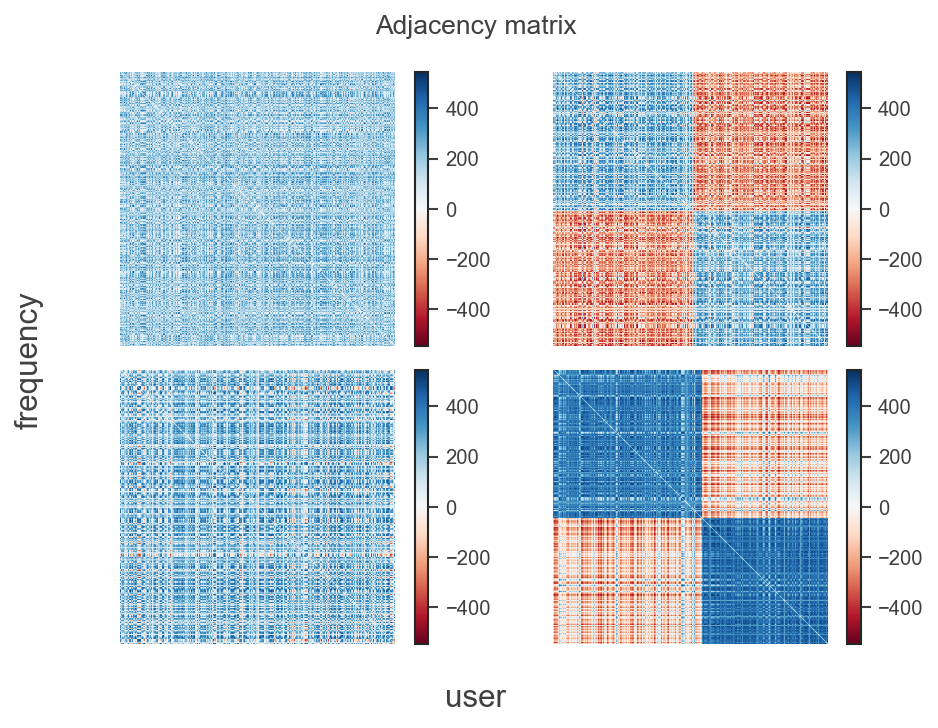

t_+ = 0.12672456933092946
t_- = 0.13987777168435037

t_+ = 1.0468520909230508
t_- = 1.065107678342685

t_+ = 1.0468520909230508
t_- = 1.065107678342685

t_+ = 1.9088330718637563
t_- = 1.947319323842934



4it [00:01,  3.03it/s]


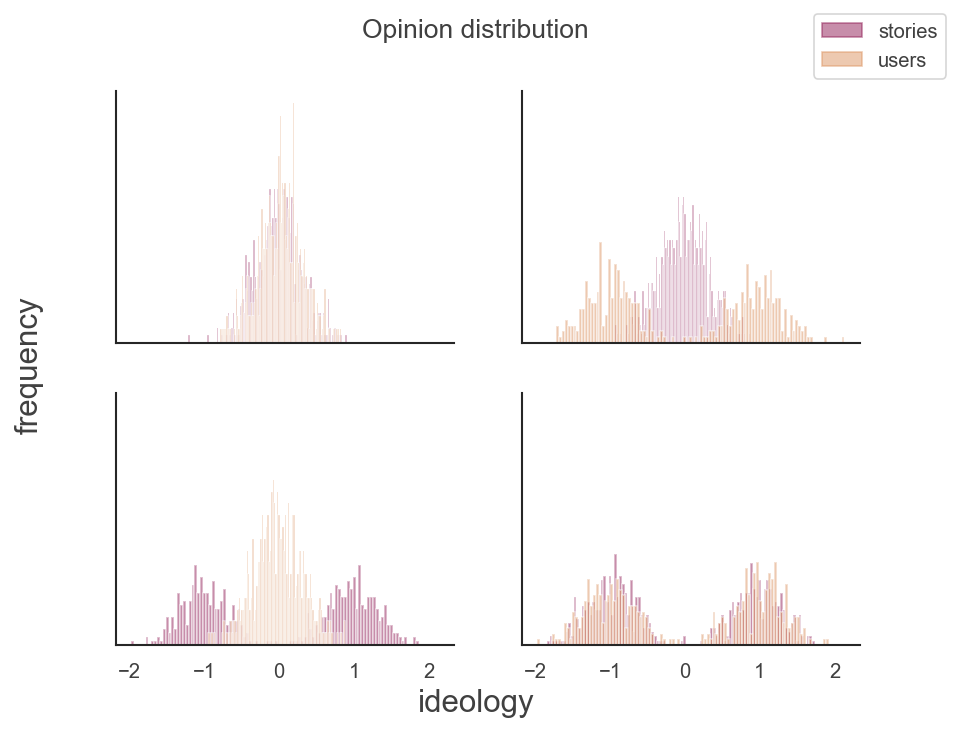

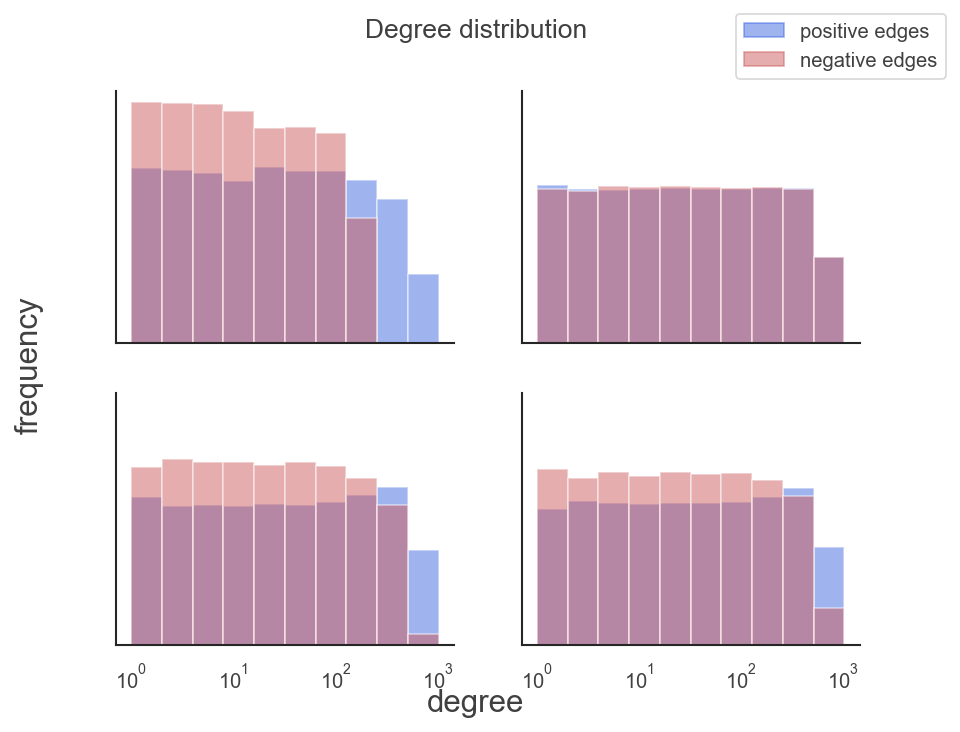

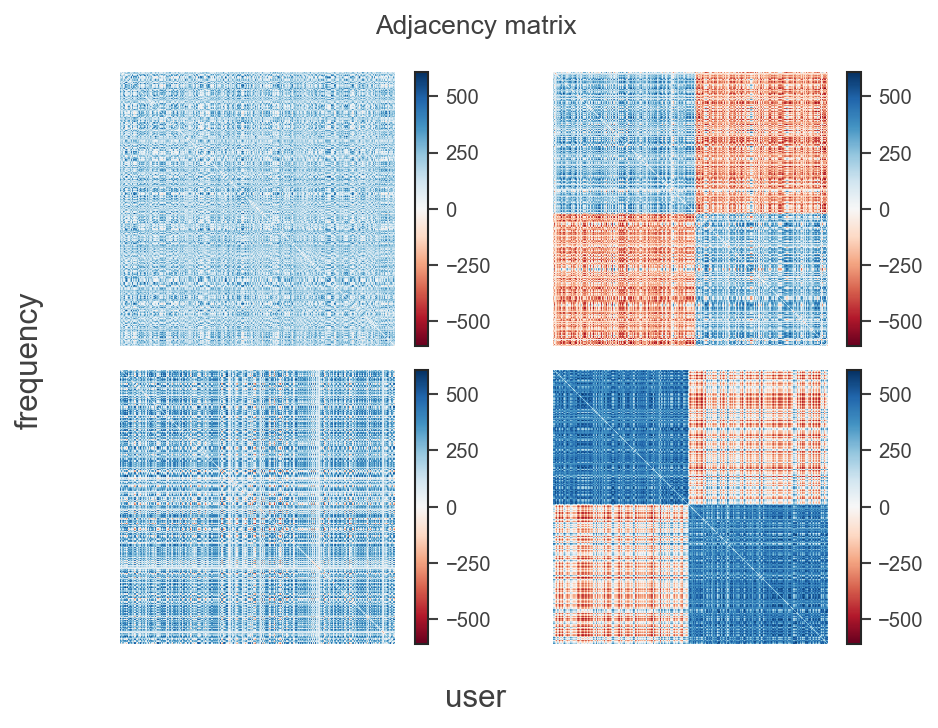

t_+ = 0.1326702812640118
t_- = 0.1525592564724562

t_+ = 1.0551871544368732
t_- = 1.0821339533460976

t_+ = 1.0551871544368732
t_- = 1.0821339533460976

t_+ = 1.9273130986149207
t_- = 1.9781503904292683



4it [00:01,  2.48it/s]


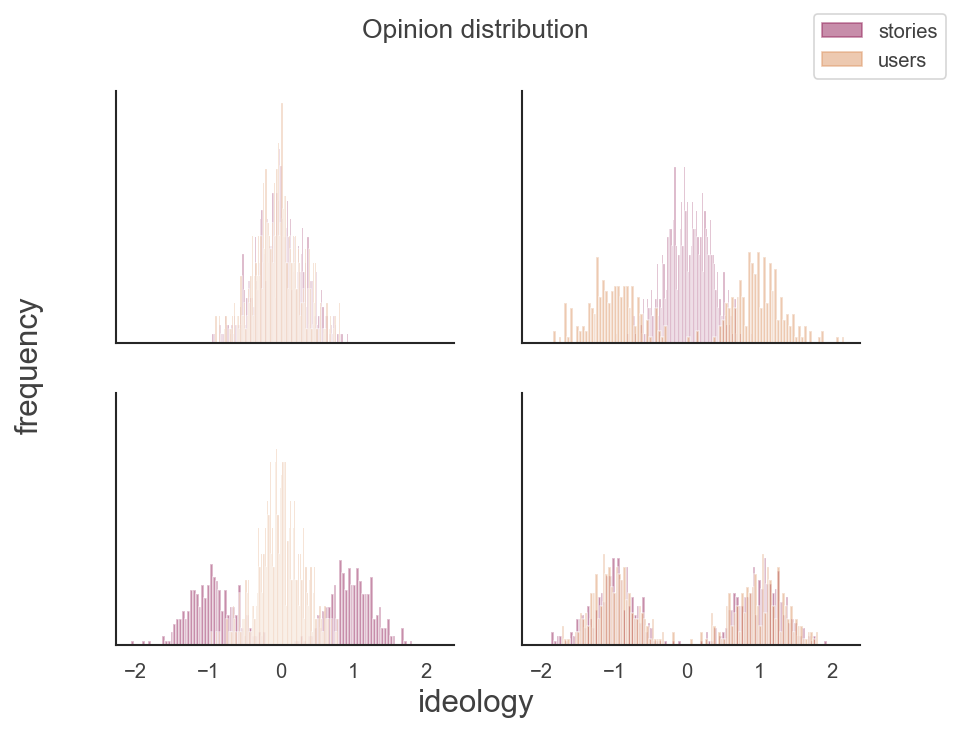

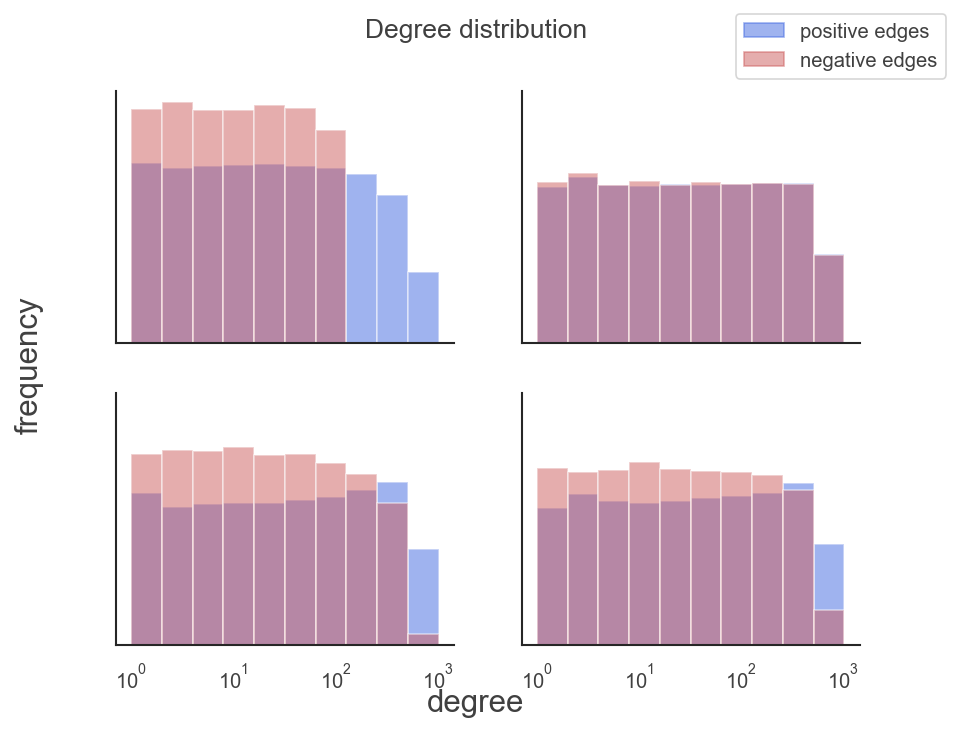

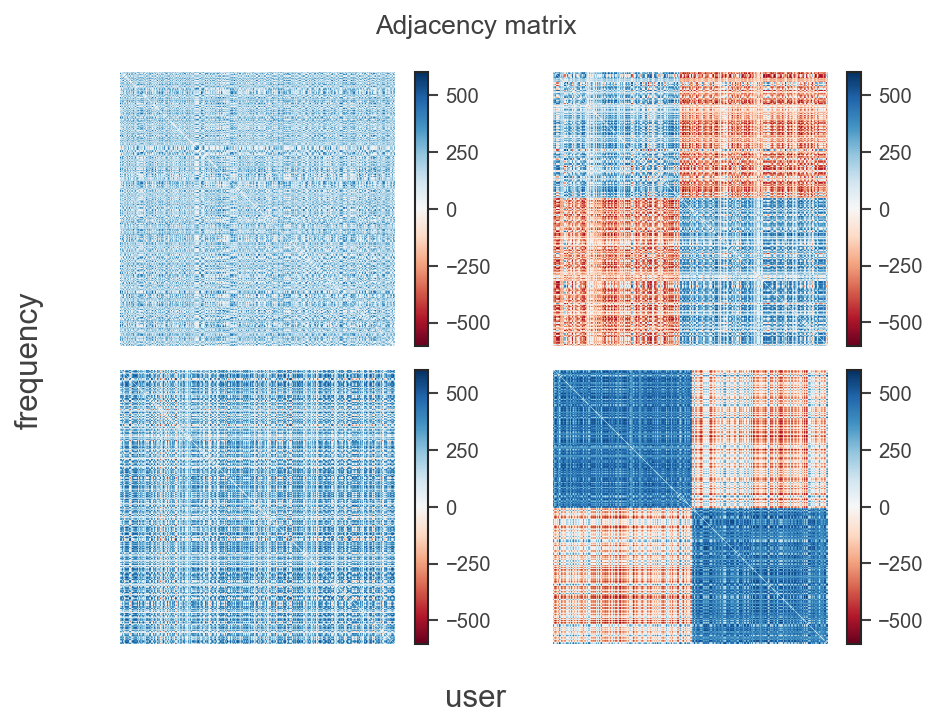

t_+ = 0.13517175638514783
t_- = 0.15652115090145494

t_+ = 1.0586520150196665
t_- = 1.0873533536529492

t_+ = 1.0586520150196665
t_- = 1.0873533536529492

t_+ = 1.9345140150437679
t_- = 1.9869414111509465



4it [00:01,  3.27it/s]


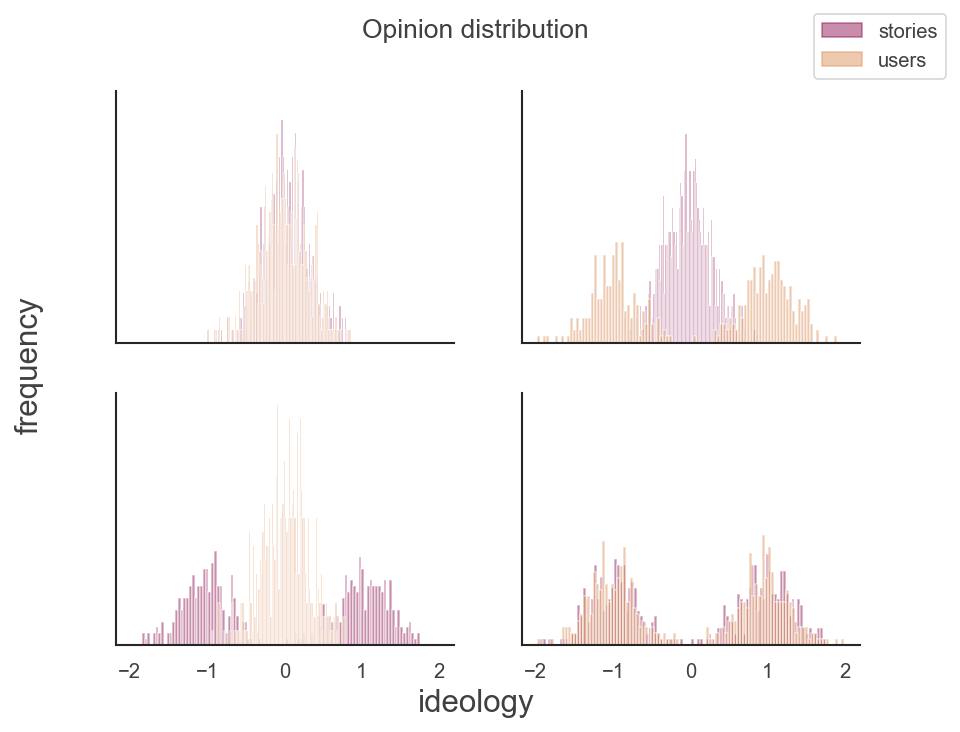

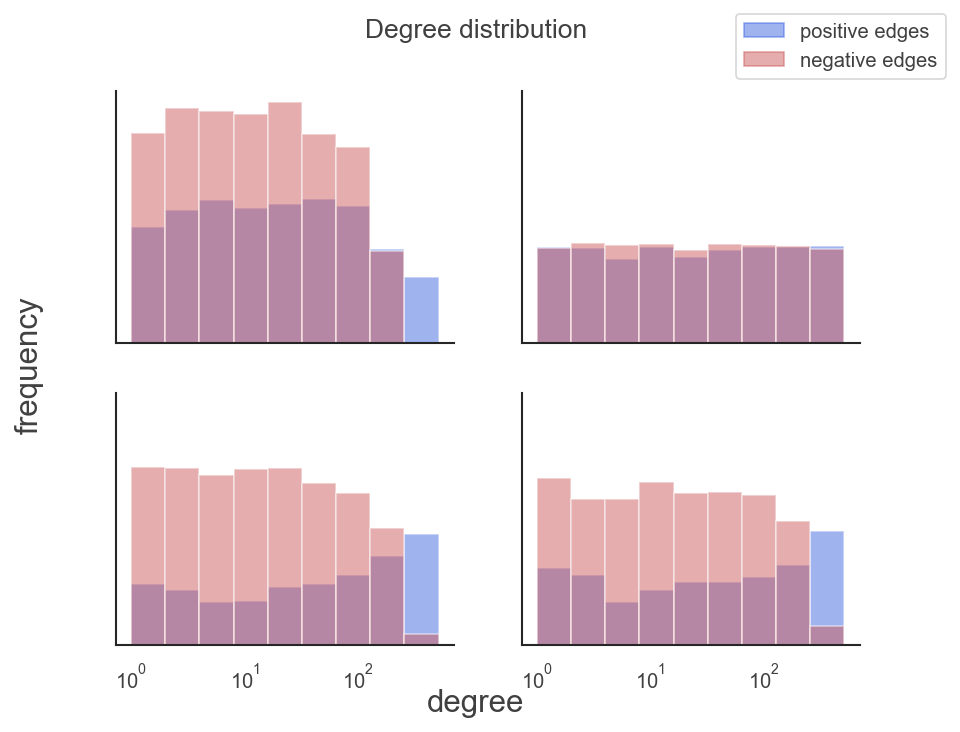

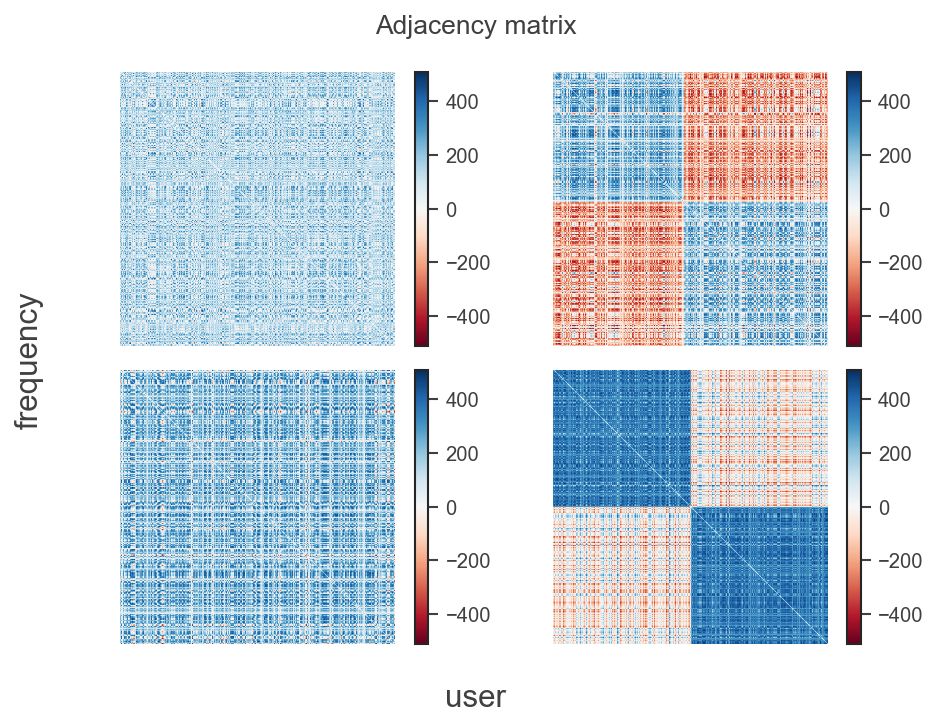

t_+ = 0.13491439908357652
t_- = 0.15247005493149066

t_+ = 1.0582966383972368
t_- = 1.0820159238097937

t_+ = 1.0582966383972368
t_- = 1.0820159238097937

t_+ = 1.9337867805019653
t_- = 1.9779485009475855



4it [00:01,  2.73it/s]


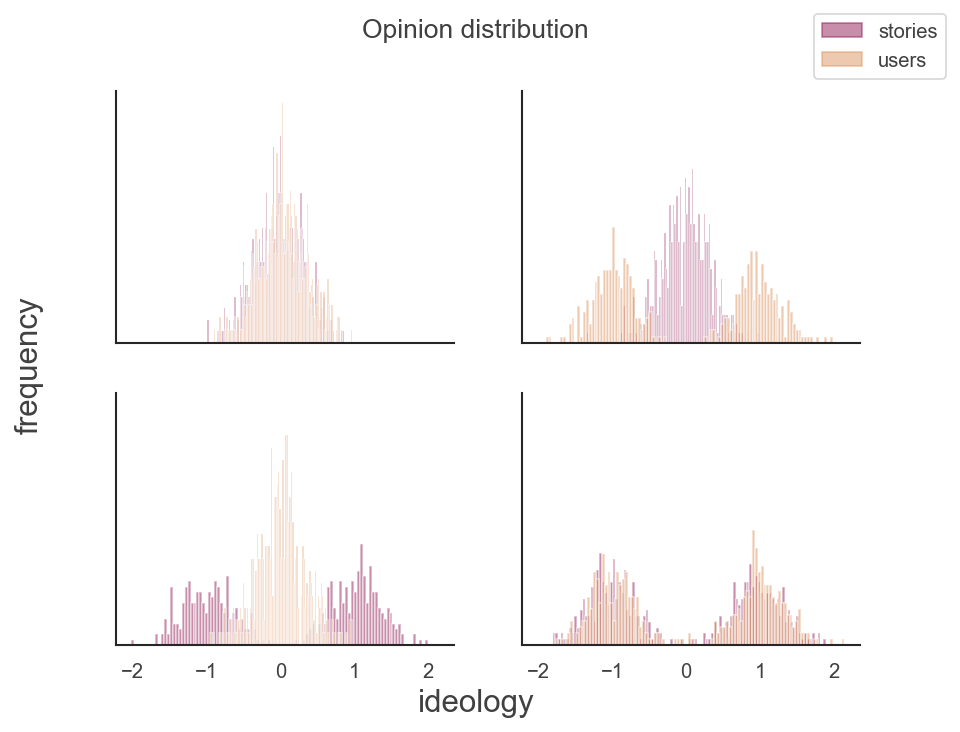

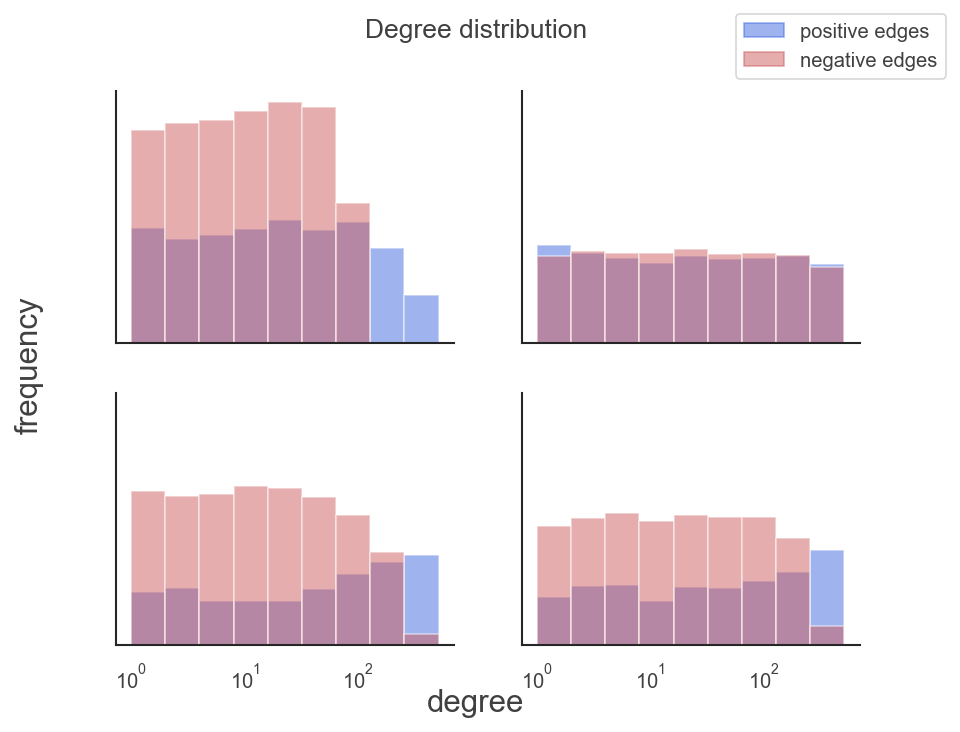

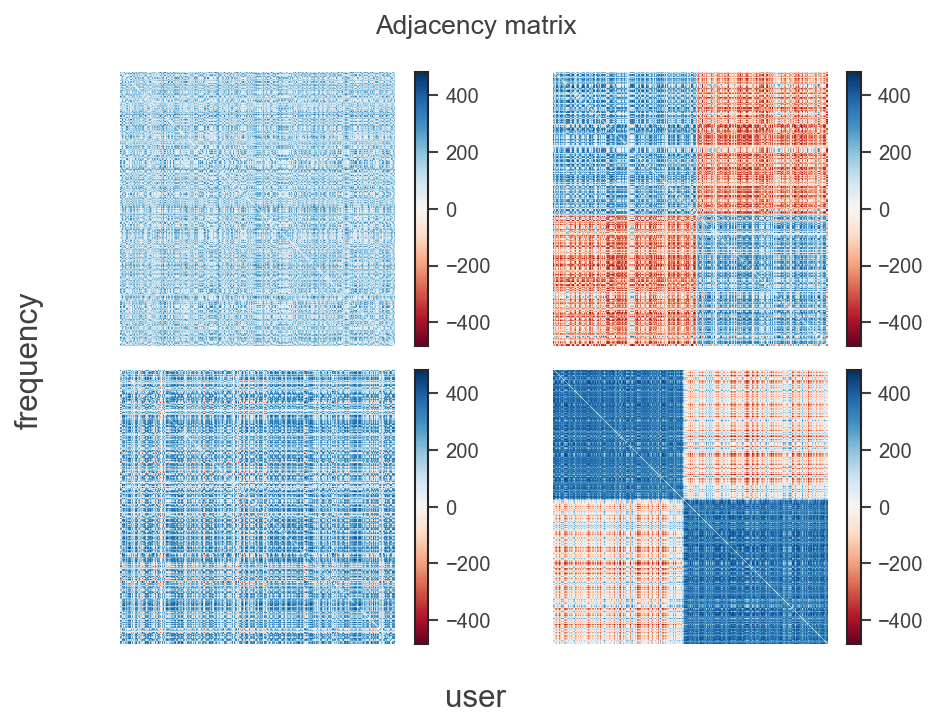

t_+ = 0.12935616410122472
t_- = 0.14319417945963708

t_+ = 1.0505590328442107
t_- = 1.0696104011014345

t_+ = 1.0505590328442107
t_- = 1.0696104011014345

t_+ = 1.9172741298137483
t_- = 1.955845205168406



4it [00:01,  2.53it/s]


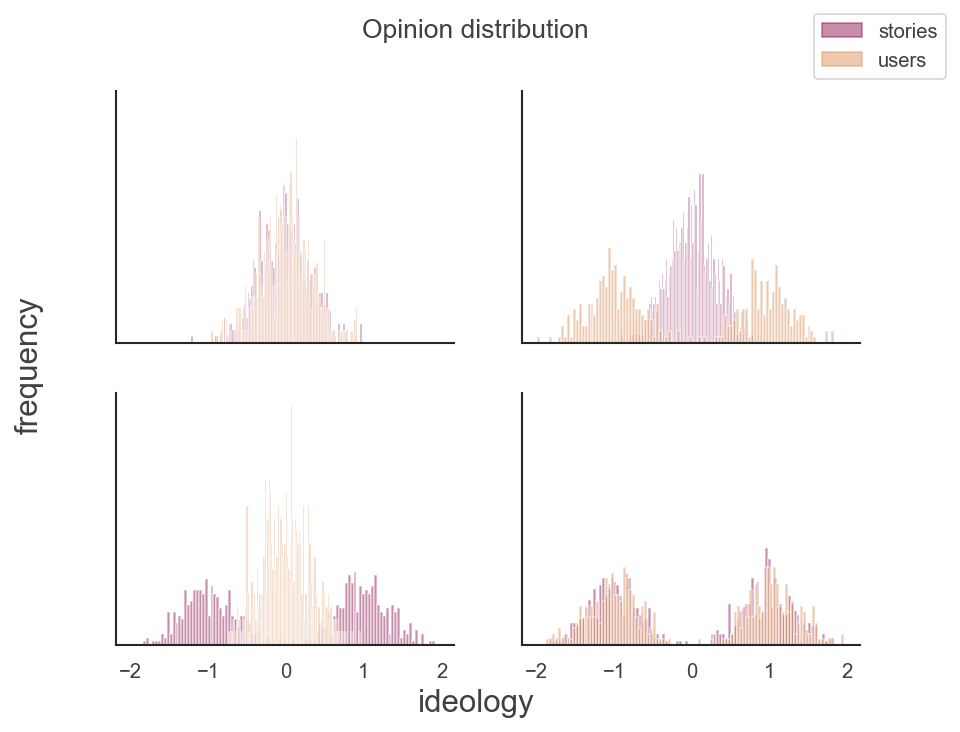

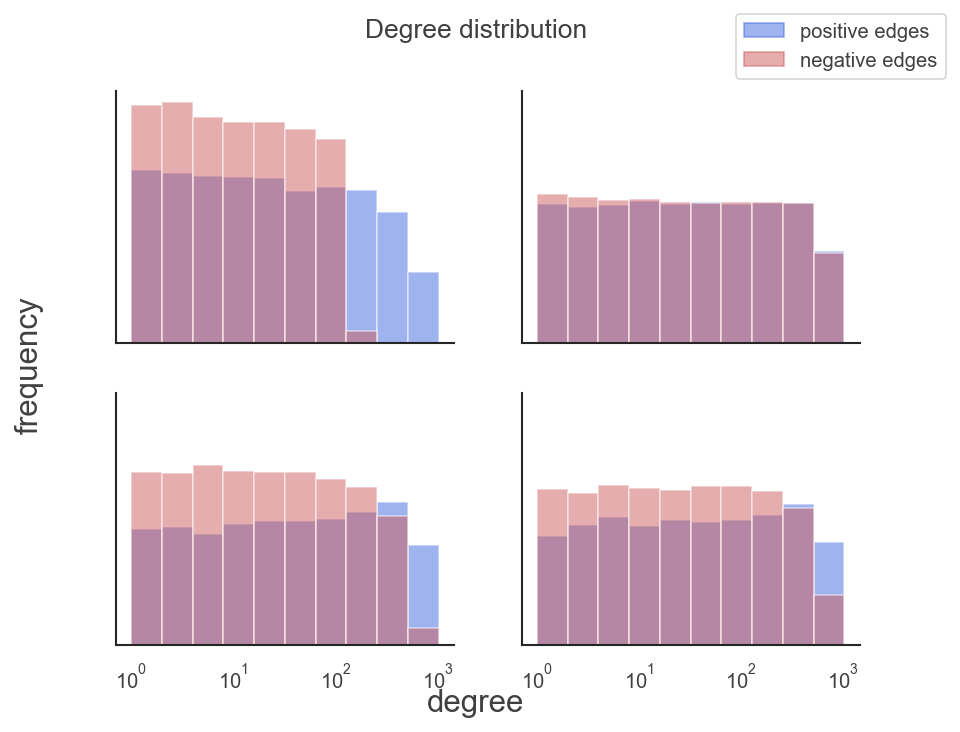

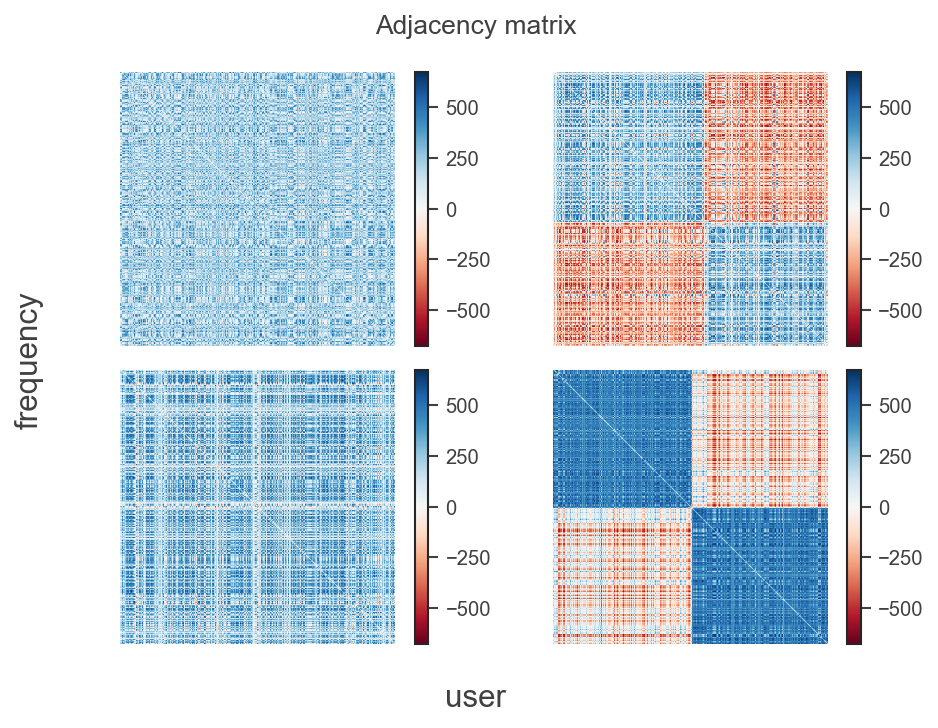

t_+ = 0.13213087428618223
t_- = 0.15123099901335793

t_+ = 1.054436849644686
t_- = 1.080374026933955

t_+ = 1.054436849644686
t_- = 1.080374026933955

t_+ = 1.9257198723427957
t_- = 1.9751250517920458



4it [00:01,  2.77it/s]


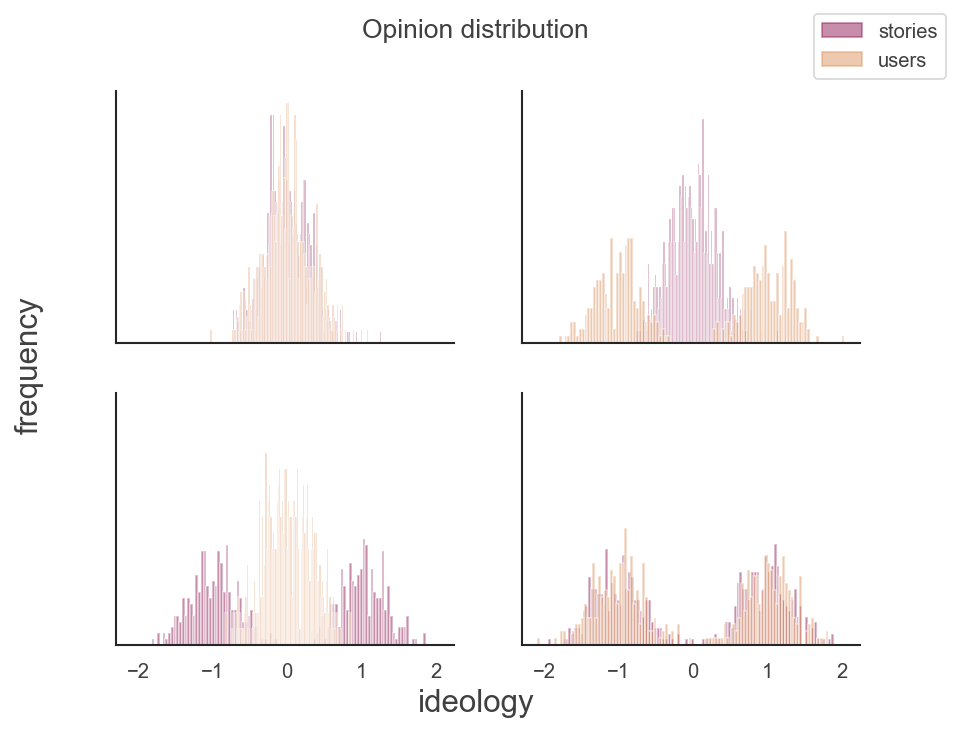

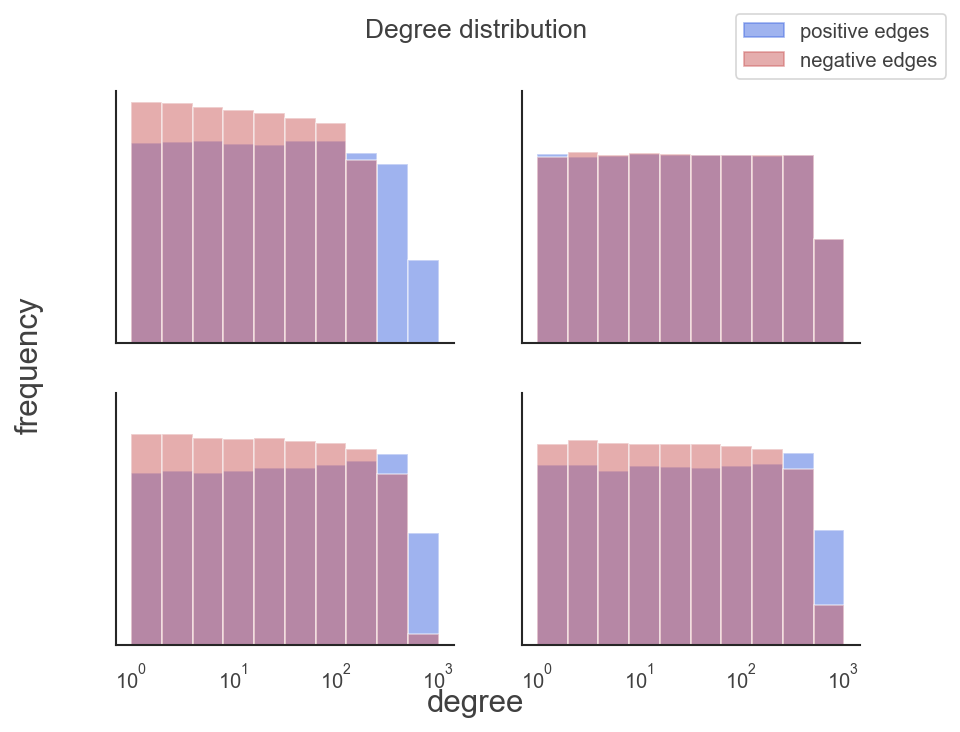

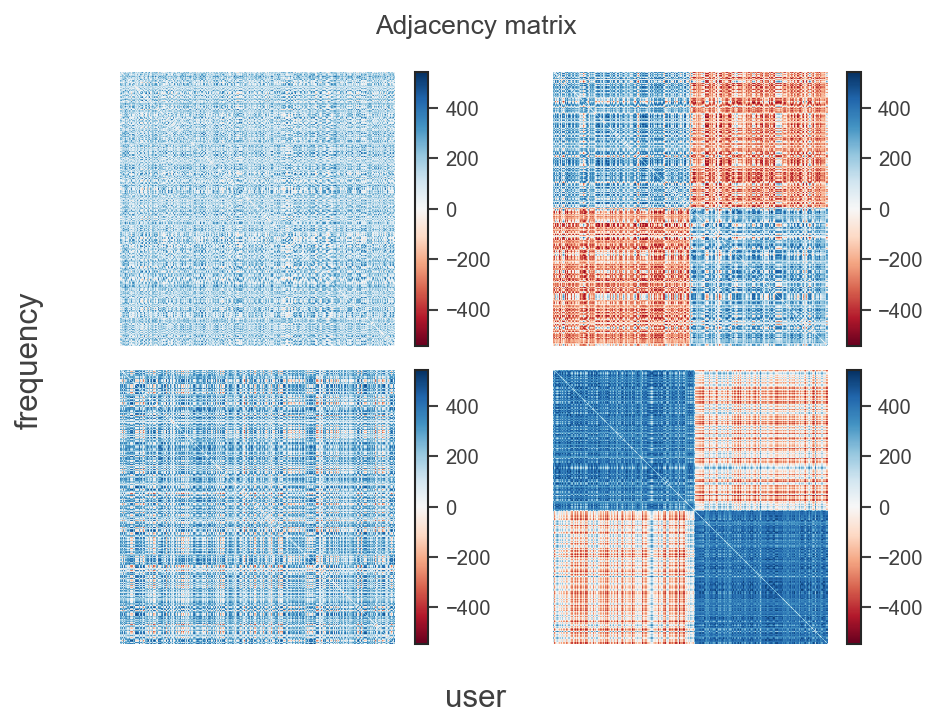

t_+ = 0.12928568698930118
t_- = 0.14413500304035115

t_+ = 1.0504601319674753
t_- = 1.0708810450351542

t_+ = 1.0504601319674753
t_- = 1.0708810450351542

t_+ = 1.917053821044499
t_- = 1.9581977466294949



4it [00:01,  2.79it/s]


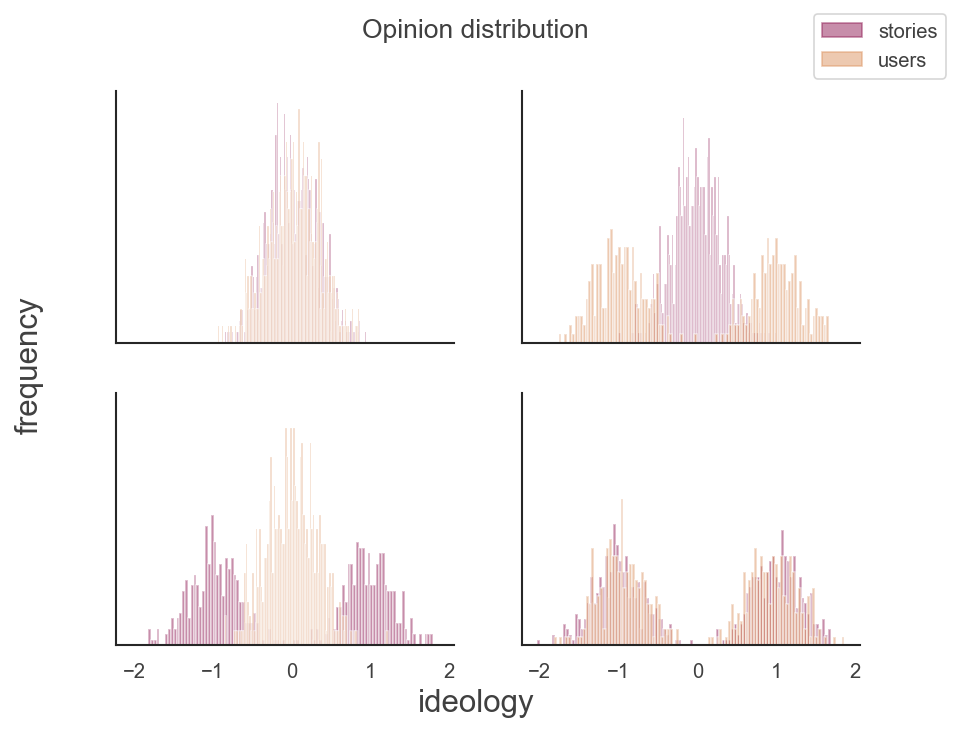

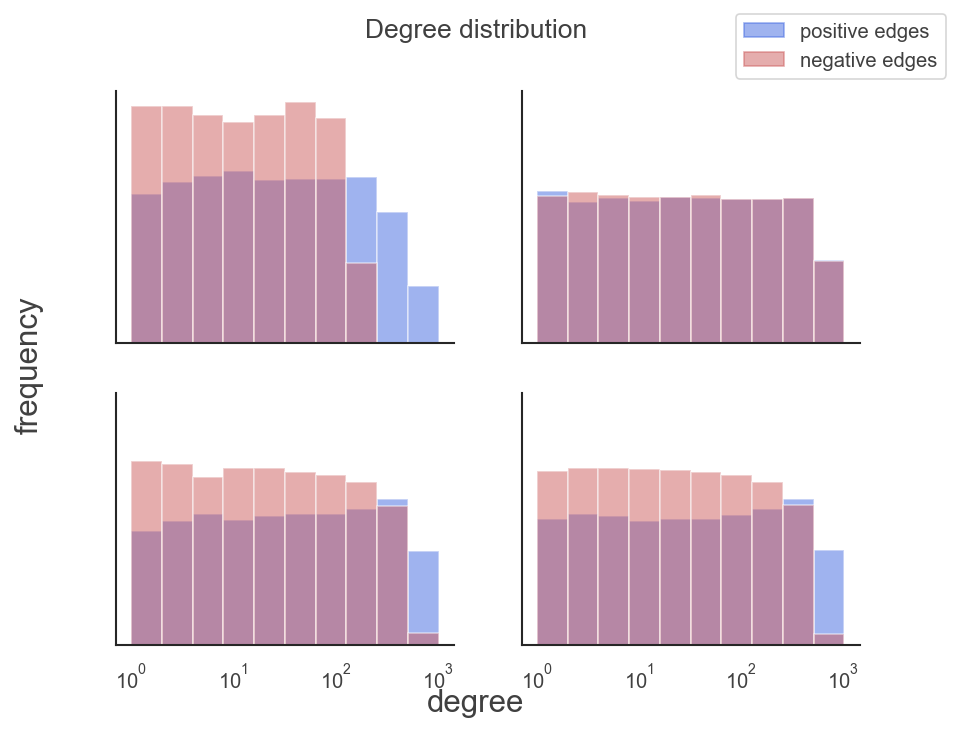

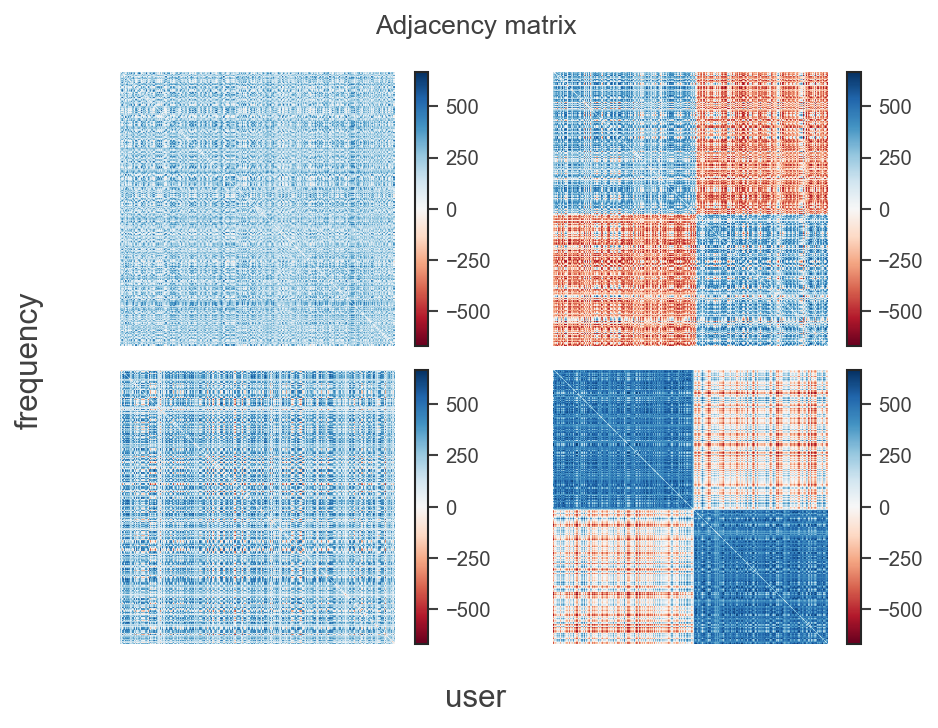

t_+ = 0.11847106093978127
t_- = 0.13345704144889917

t_+ = 1.0350277120700433
t_- = 1.056279496392543

t_+ = 1.0350277120700433
t_- = 1.056279496392543

t_+ = 1.8787497511722175
t_- = 1.9296104687703628



4it [00:01,  2.51it/s]


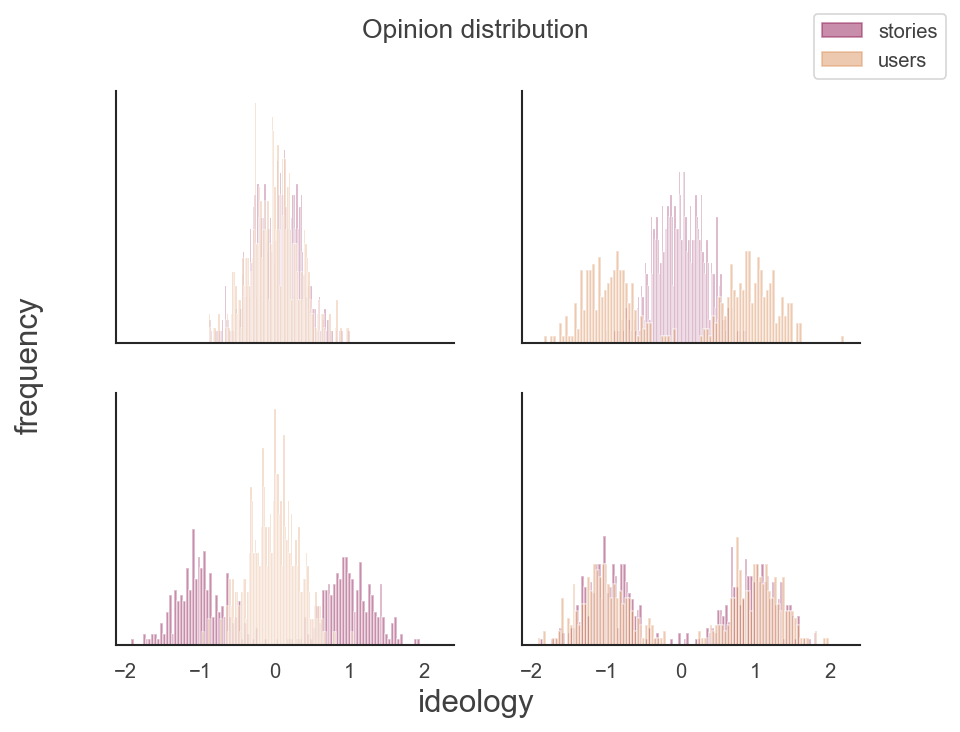

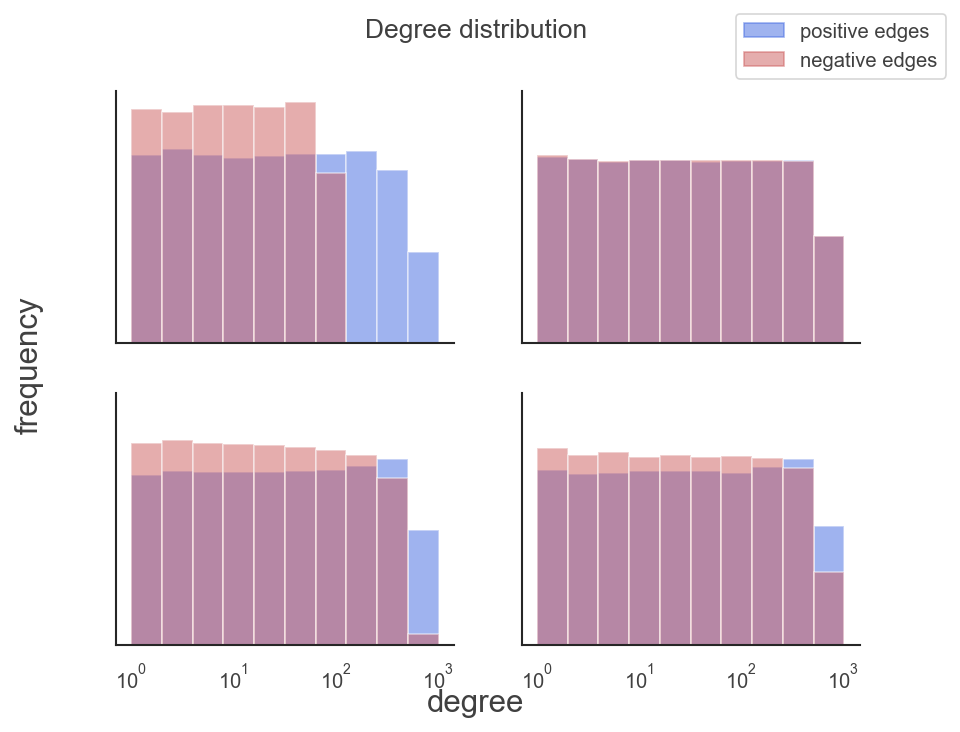

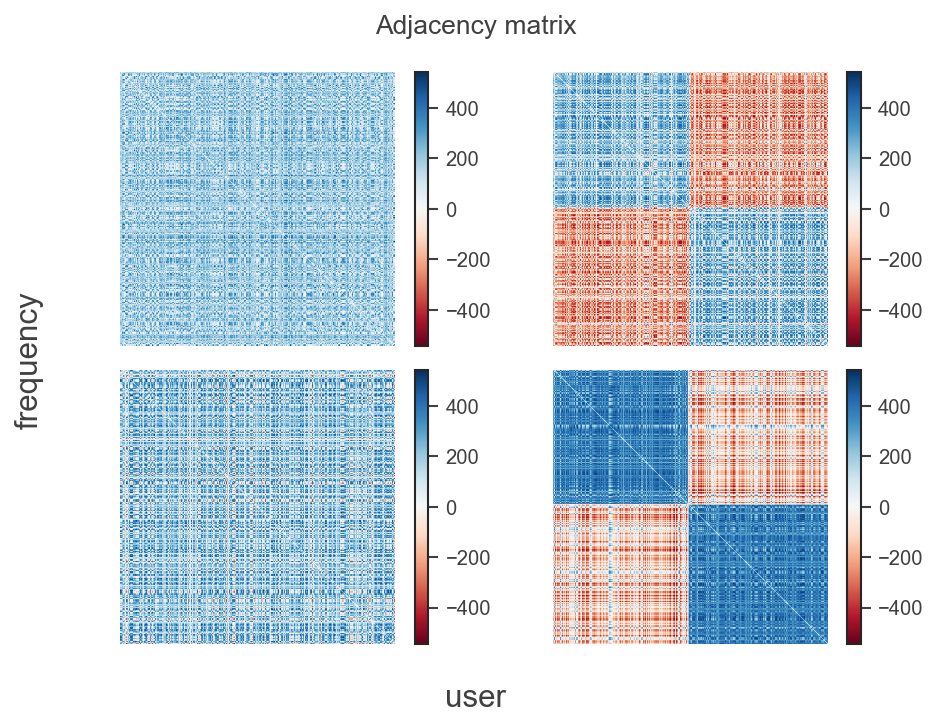

t_+ = 0.11171954249701276
t_- = 0.1292730676117658

t_+ = 1.0251081668759374
t_- = 1.050442420982611

t_+ = 1.0251081668759374
t_- = 1.050442420982611

t_+ = 1.847801108720914
t_- = 1.9170143415049627



4it [00:01,  2.25it/s]


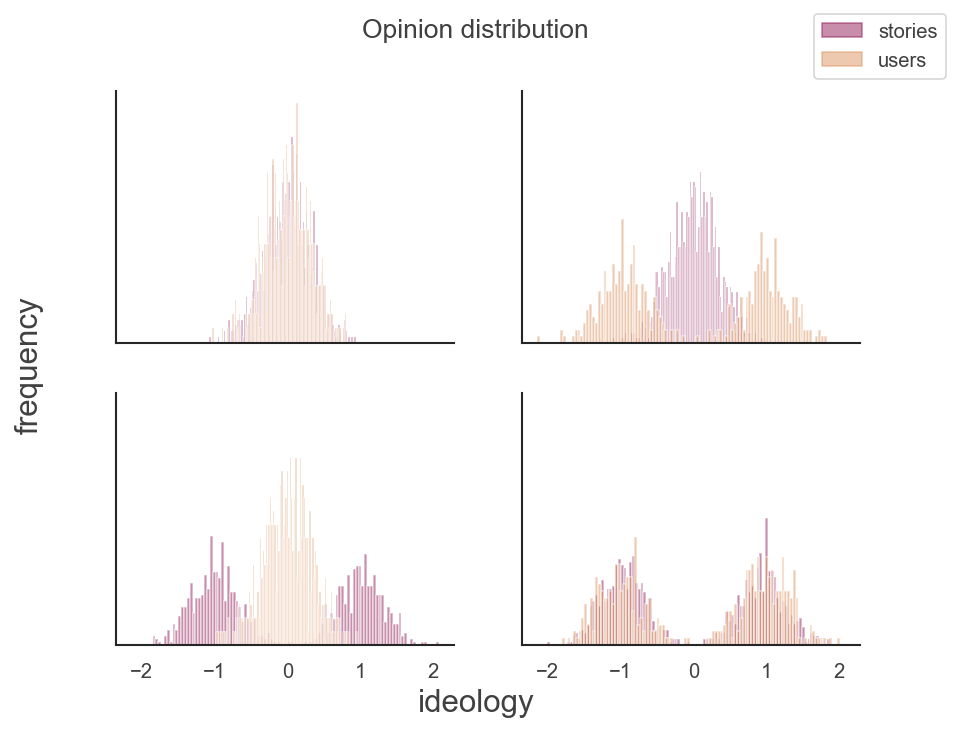

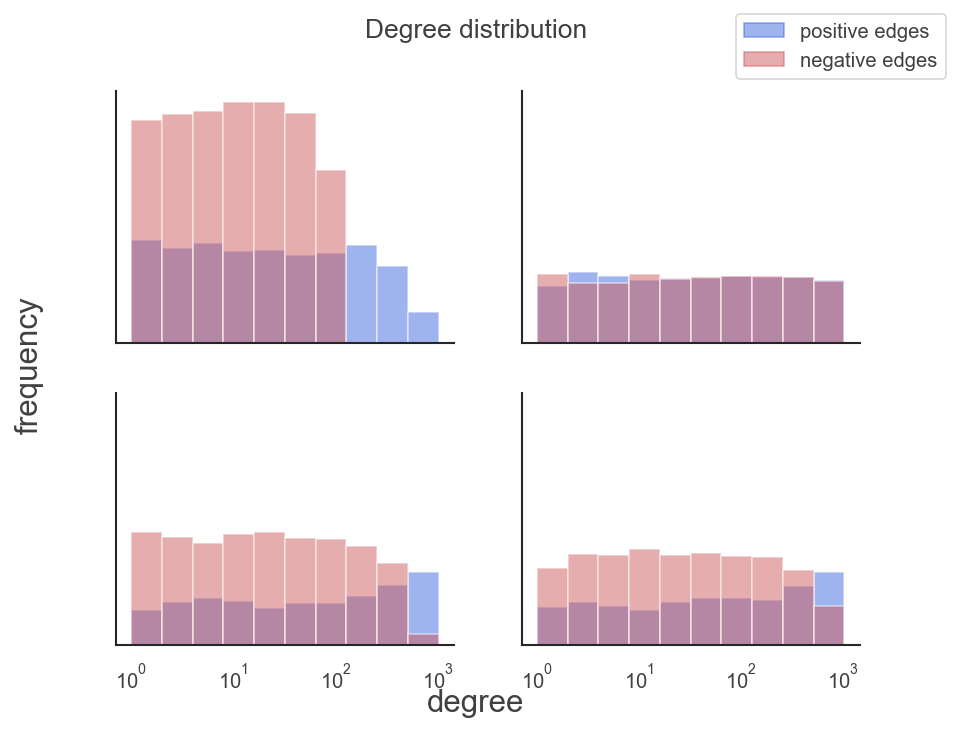

In [24]:
sigma = 0.1
amplitude = 0.5
for year in df['year'].unique():
    df_year = df[df['year'] == year]
    n_users = len(df_year['username_vote'].unique())
    n_stories = len(df_year['story_id'].unique())
    v_pos, v_neg = prob_voting(df_year, queue=False, meneame=False)
    t_p, t_m = thresholds_scenarios(amplitude, sigma, v_pos, v_neg)

    # Define constants
    paths = ['u_np_s_np.pkl', 'u_p_s_np.pkl', 'u_np_s_p.pkl', 'u_p_s_p.pkl']

    path_adj = f'./data/us-house/synth/{year}/uniform/adj/'
    path_label = f'./data/us-house/synth/{year}/uniform/label/'

    # Create subplots
    figs, axs = zip(*[plt.subplots(2, 2, sharex=True, sharey=True) for _ in range(3)])

    # Set titles
    titles = ['Opinion distribution', 'Degree distribution', 'Adjacency matrix']
    for fig, title in zip(figs, titles):
        fig.suptitle(title)

    # Process each scenario
    for i, scenario in tqdm(enumerate(scenarios)):
        dist_users, dist_stories = scenario
        t_plus, t_minus = t_p[scenario], t_m[scenario]
        users, users_labels, stories, stories_labels = plot_hist(amplitude, dist_users, dist_stories, sigma, n_users, n_stories, ax=axs[0].flat[i])

        # Create adjacency matrix
        mat = fill_mat(users, stories, t_plus, t_minus, deg_p_seq, deg_m_seq, deg_corr = False)
        A = (csr_matrix(mat) @ csr_matrix(mat).T).todense()
        np.fill_diagonal(A, 0)

        # Plot adjacency matrix
        im = axs[2].flat[i].imshow(A, cmap='RdBu', vmin=-np.max(A), vmax=np.max(A))
        axs[2].flat[i].axis('off')
        plt.colorbar(im, ax=axs[2].flat[i])

        # Calculate balanced triangles
        #sb[i] = np.array(fraction_balanced_triangles(A))

        # Save adjacency matrix and labels
        for path, data in zip([path_adj, path_label], [A, users_labels]):
            create_directory(path)
            #with open(path + paths[i], 'wb') as f:
             #   pickle.dump(data, f)

        # Plot degree distribution
        plot_deg_distr(A, ax=axs[1].flat[i])

    # Add legends
    legends = [legend1, legend2]
    colors = [colors1, colors2]
    for fig, legend, color in zip(figs[:2], legends, colors):
        patches = [mpatches.Patch(color=c, label=l, alpha=0.5) for c, l in zip(color, legend)]
        fig.legend(handles=patches, bbox_to_anchor=(1, 1))

    # Set labels
    labels = ['ideology', 'degree', 'user']
    for fig, label in zip(figs, labels):
        fig.supxlabel(label, size=15)
        fig.supylabel('frequency', size=15)

    plt.tight_layout()
    plt.show()
    

4it [00:07,  1.76s/it]


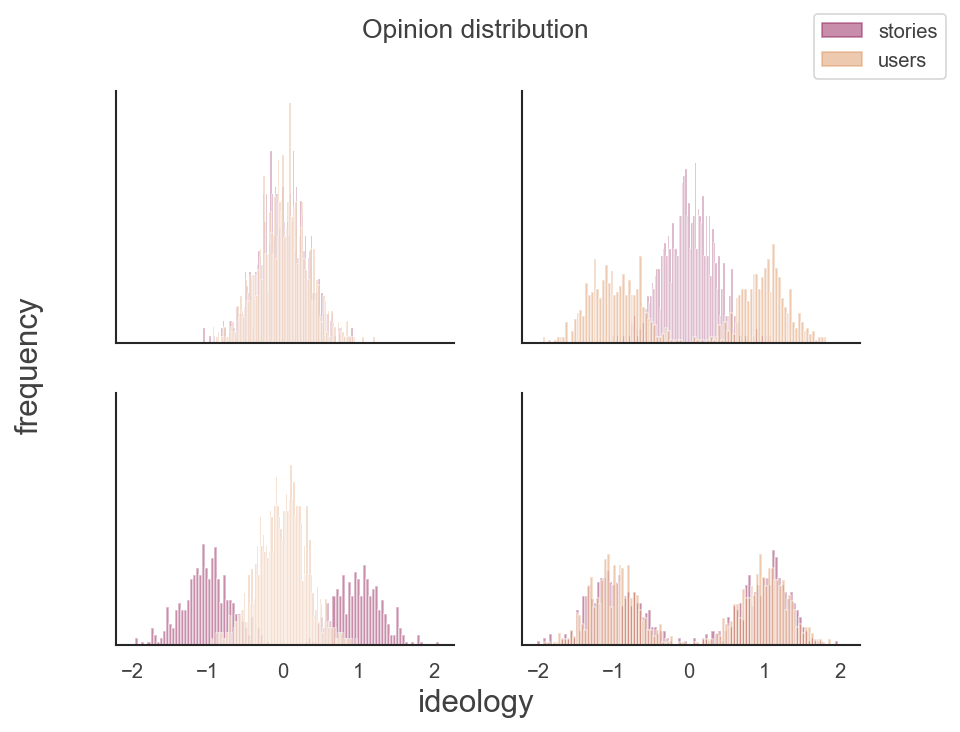

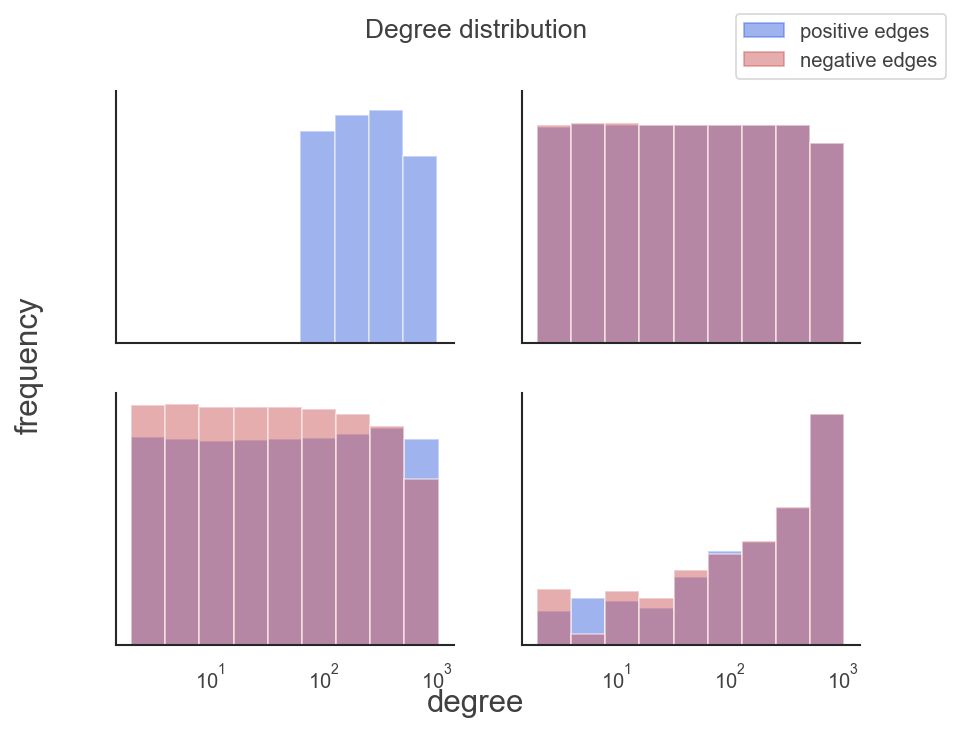

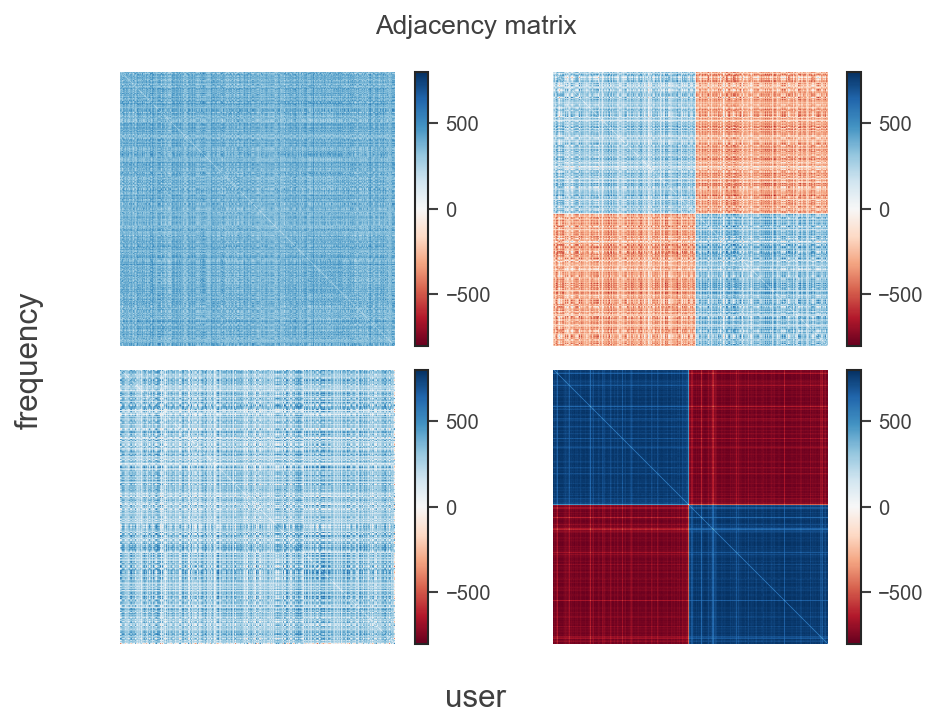

In [19]:
# Define constants
paths = ['u_np_s_np.pkl', 'u_p_s_np.pkl', 'u_np_s_p.pkl', 'u_p_s_p.pkl']
path_adj = './scenarios_full/adj/'
path_label = './scenarios_full/label/'

# Create subplots
figs, axs = zip(*[plt.subplots(2, 2, sharex=True, sharey=True) for _ in range(3)])

# Set titles
titles = ['Opinion distribution', 'Degree distribution', 'Adjacency matrix']
for fig, title in zip(figs, titles):
    fig.suptitle(title)

# Process each scenario
for i, scenario in tqdm(enumerate(scenarios)):
    dist_users, dist_stories = scenario
    t_plus, t_minus = t_p[scenario], t_m[scenario]
    users, users_labels, stories, stories_labels = plot_hist(amplitude, dist_users, dist_stories, sigma, n_users, n_stories, ax=axs[0].flat[i])

    # Create adjacency matrix
    mat = fill_mat(users, stories, t_plus, t_minus, deg_p_seq, deg_m_seq, deg_corr = False)
    A = (csr_matrix(mat) @ csr_matrix(mat).T).todense()
    np.fill_diagonal(A, 0)

    # Plot adjacency matrix
    im = axs[2].flat[i].imshow(A, cmap='RdBu', vmin=-np.max(A), vmax=np.max(A))
    axs[2].flat[i].axis('off')
    plt.colorbar(im, ax=axs[2].flat[i])

    # Calculate balanced triangles
    #sb[i] = np.array(fraction_balanced_triangles(A))

    # Save adjacency matrix and labels
    for path, data in zip([path_adj, path_label], [A, users_labels]):
        create_directory(path)
        with open(path + paths[i], 'wb') as f:
            pickle.dump(data, f)

    # Plot degree distribution
    plot_deg_distr(A, ax=axs[1].flat[i])

# Add legends
legends = [legend1, legend2]
colors = [colors1, colors2]
for fig, legend, color in zip(figs[:2], legends, colors):
    patches = [mpatches.Patch(color=c, label=l, alpha=0.5) for c, l in zip(color, legend)]
    fig.legend(handles=patches, bbox_to_anchor=(1, 1))

# Set labels
labels = ['ideology', 'degree', 'user']
for fig, label in zip(figs, labels):
    fig.supxlabel(label, size=15)
    fig.supylabel('frequency', size=15)

plt.tight_layout()
plt.show()